# miχpods: MOM6

- [ ] baseline KPP missing
- [ ] bootstrap error on mean, median?
- [ ] Try daily vs hourly
- [ ] add TAO χpods
- [ ] fix EUC max at 110
- [ ] figure out time base
- [ ] shear spectra

- [ ] check eps vs Ri histogram
  - I think my Ri is too low?


Questions:
- [x] N2 vs N2T
- [x] match time intervals
- [ ] match vertical resolution and extent
- [ ] restrict TAO S2 to ADCP depth range
- [ ] restrict to top 200m.

Notes:
- Filtering out MLD makes a big difference!
- SInce we're working with derivatives does the vertical grid matter (as long as it is coarser than observations)?

```
1 difvho ocean_vertical_heat_diffusivity 
2 difvso ocean_vertical_salt_diffusivity
```

- Need lateral / neutral terms for total χ, ε
- Why can't I reproduce the ε figure?
- Why can't I save the new station data
- Need to consider Ri smoothing in models:
  From Gustavo:
  > You mentioned some kind of inconsistency between your diagnostics and what MOM6 was doing for the interior shear mixing scheme. I am working to implement the option to apply vertical smoothing in Ri multiple times, instead of only once which is what we are doing right now. I noticed that the diagnostic `ri_grad_shear` is saved before the smoothing is applied. There is another diagnostic (`ri_grad_shear_smooth`) that saves the smoothed Ri. Perhaps you were looking at ri_grad_shear instead of ri_grad_shear_smooth and this can explain the inconsistency. 

## Diagnostics notes

- go through `prepare`; pass in dataset and optional `xgcm.Grid`
- different pre-processing steps for different datasets
- order, sign of z coordinate is painful; here normalizing
- composing with matplotlib subfigures
- 


## References

Warner & Moum (2019)

## Setup

In [ ]:
%load_ext watermark

import datetime
import glob
import os
import warnings

import cf_xarray as cfxr
import dask
import dask_jobqueue
import dcpy
import distributed
import flox.xarray
import holoviews as hv
import hvplot.xarray
import matplotlib as mpl
import matplotlib.pyplot as plt
import mom6_tools
import numpy as np
import pandas as pd
import xarray as xr
import xgcm
from holoviews import opts

%aimport pump
from pump import mixpods

hv.notebook_extension("bokeh")
s
cfxr.set_options(warn_on_missing_variables=False)
plt.style.use("bmh")
plt.rcParams["figure.dpi"] = 140
xr.set_options(keep_attrs=True, display_expand_data=False)

gcmdir = "/glade/campaign/cgd/oce/people/bachman/TPOS_1_20_20_year/OUTPUT/"  # MITgcm output directory
stationdirname = gcmdir

mixing_layer_depth_criteria = {
    "boundary_layer_depth": {"name": "KPPhbl|KPP_OBLdepth|ePBL_h_ML"},
}

# MOM6 run catalog
catalog = {
    "baseline": (
        "baseline",
        "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixpods",
    ),
    "epbl": ("ePBL", "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.epbl.001.mixpods"),
    "kpp.lmd.002": (
        "KPP Ri0=0.5",
        "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.kpp.lmd.002.mixpods",
    ),
    "kpp.lmd.003": (
        "KPP Ri0=0.5, Ric=0.2,",
        "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.kpp.lmd.003.mixpods",
    ),
    "kpp.lmd.004": (
        "KPP ν0=2.5, Ric=0.2, Ri0=0.5",
        "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.kpp.lmd.004.mixpods",
    ),
}

%watermark -iv

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/dask_jobqueue/core.py:20: FutureWarning: tmpfile is deprecated and will be removed in a future release. Please use dask.utils.tmpfile instead.
  from distributed.utils import tmpfile


dask_jobqueue: 0.7.3
xgcm         : 0.6.1
sys          : 3.10.8 | packaged by conda-forge | (main, Nov 22 2022, 08:26:04) [GCC 10.4.0]
dcpy         : 0.1.dev385+g121534c
distributed  : 2022.11.1
xarray       : 2022.12.0
matplotlib   : 3.6.2
holoviews    : 1.15.2
pandas       : 1.5.2
dask         : 2022.11.1
hvplot       : 0.8.2
mom6_tools   : 0.0.post244
json         : 2.0.9
cf_xarray    : 0.7.5
flox         : 0.6.5
numpy        : 1.23.5
pump         : 0.1



In [ ]:
if "client" in locals():
    client.close()
    del client
if "cluster" in locals():
    cluster.close()

# env = {"OMP_NUM_THREADS": "3", "NUMBA_NUM_THREADS": "3"}

# cluster = distributed.LocalCluster(
#    n_workers=8,
#    threads_per_worker=1,
#    env=env
# )

if "cluster" in locals():
    del cluster

# cluster = ncar_jobqueue.NCARCluster(
#    project="NCGD0011",
#    scheduler_options=dict(dashboard_address=":9797"),
# )
# cluster = dask_jobqueue.PBSCluster(
#    cores=9, processes=9, memory="108GB", walltime="02:00:00", project="NCGD0043",
#    env_extra=env,
# )


cluster = dask_jobqueue.PBSCluster(
    cores=2,  # The number of cores you want
    memory="23GB",  # Amount of memory
    processes=1,  # How many processes
    queue="casper",  # The type of queue to utilize (/glade/u/apps/dav/opt/usr/bin/execcasper)
    # log_directory="/glade/scratch/dcherian/dask/",  # Use your local directory
    resource_spec="select=1:ncpus=1:mem=23GB",  # Specify resources
    project="ncgd0011",  # Input your project ID here
    walltime="02:00:00",  # Amount of wall time
    interface="ib0",  # Interface to use
)
cluster.adapt(maximum_jobs=12, minimum_jobs=2)
client = distributed.Client(cluster)
client

Connection method: Cluster object,Cluster type: dask_jobqueue.PBSCluster
Dashboard: https://jupyterhub.hpc.ucar.edu/stable/user/dcherian/proxy/8787/status,
Dashboard: https://jupyterhub.hpc.ucar.edu/stable/user/dcherian/proxy/8787/status,Workers: 0
Total threads: 0,Total memory: 0 B
Comm: tcp://10.12.206.51:37022,Workers: 0
Dashboard: https://jupyterhub.hpc.ucar.edu/stable/user/dcherian/proxy/8787/status,Total threads: 0
Started: Just now,Total memory: 0 B


## Read data

### TAO

In [ ]:
tao_Ri = xr.load_dataarray(
    "tao-hourly-Ri-seasonal-percentiles.nc"
).cf.guess_coord_axis()

In [ ]:
tao_gridded = xr.open_dataset(
    os.path.expanduser("~/work/pump/zarrs/tao-gridded-ancillary.zarr"),
    chunks="auto",
    engine="zarr",
).sel(longitude=-140, time=slice("1996", None))
tao_gridded["depth"].attrs["axis"] = "Z"
tao_gridded["shallowest"].attrs.clear()

tao_gridded["Tz"] = tao_gridded.T.cf.differentiate("Z")
tao_gridded.Tz.attrs = {"long_name": "$T_z$", "units": "℃/m"}
tao_gridded["Sz"] = tao_gridded.S.cf.differentiate("Z")
tao_gridded.Sz.attrs = {"long_name": "$S_z$", "units": "g/kg/m"}

chipod = (
    dcpy.oceans.read_cchdo_chipod_file(
        "~/datasets/microstructure/osu/chipods_0_140W.nc"
    )
    .sel(time=slice("2015"))
    # move from time on the half hour to on the hour
    .coarsen(time=2, boundary="trim")
    .mean()
    # "Only χpods between 29 and 69 m are used in this analysis as
    # deeper χpods are more strongly influenced by the variability of zEUC than by surface forcing."
    # - Warner and Moum (2019)
    .sel(depth=slice(29, 69))
    .reindex(time=tao_gridded.time, method="nearest", tolerance="5min")
    .pipe(mixpods.normalize_z, sort=True)
)

tao_gridded = tao_gridded.update(
    chipod[["chi", "KT", "eps", "Jq"]]
    .reset_coords(drop=True)
    .rename({"depth": "depthchi"})
)

tao_gridded = mixpods.prepare(tao_gridded, oni=pump.obs.process_oni())

# tao_gridded = tao_gridded.update(
#    mixpods.pdf_N2S2(tao_gridded.drop_vars(["shallowest", "zeuc"]))
# )
# tao_gridded = mixpods.load(tao_gridded)

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/core/dataset.py:248: UserWarning: The specified Dask chunks separate the stored chunks along dimension "depth" starting at index 42. This could degrade performance. Instead, consider rechunking after loading.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/core/dataset.py:248: UserWarning: The specified Dask chunks separate the stored chunks along dimension "time" starting at index 199726. This could degrade performance. Instead, consider rechunking after loading.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/core/dataset.py:248: UserWarning: The specified Dask chunks separate the stored chunks along dimension "longitude" starting at index 2. This could degrade performance. Instead, consider rechunking after loading.
  warnings.warn(


In [ ]:
np.log10(tao_gridded.eps).sel(time=slice("2005", "2015")).resample(
    time="M"
).mean().hvplot.quadmesh(clim=(-7.5, -6))

:QuadMesh   [time,depthchi]   (eps)

In [ ]:
sub = tao_gridded.sel(time="2010-01")

t = sub.theta.hvplot.quadmesh(cmap="turbo_r")
dt = (
    sub.theta - sub.theta.reset_coords(drop=True).cf.sel(Z=[0, -5]).cf.max("Z")
).hvplot.quadmesh(clim=(-0.15, 0.15), cmap="RdBu_r")
newmld = mixpods.get_mld_tao_theta(sub.theta.reset_coords(drop=True))

(
    dt
    * sub.reset_coords().mldT.hvplot.line(color="w", line_width=2)
    * newmld.reset_coords(drop=True).hvplot.line(color="orange", line_width=1)
).opts(frame_width=1200)

:Overlay
   .QuadMesh.I :QuadMesh   [time,depth]   (theta)
   .Curve.I    :Curve   [time]   (mldT)
   .Curve.II   :Curve   [time]   (mldT)

In [ ]:
(
    tao_gridded.reset_coords().mldT.resample(time="5D").mean().hvplot.line()
    * mixpods.get_mld_tao_theta((tao_gridded.reset_coords().theta))
    .resample(time="5D")
    .mean()
    .hvplot.line()
)

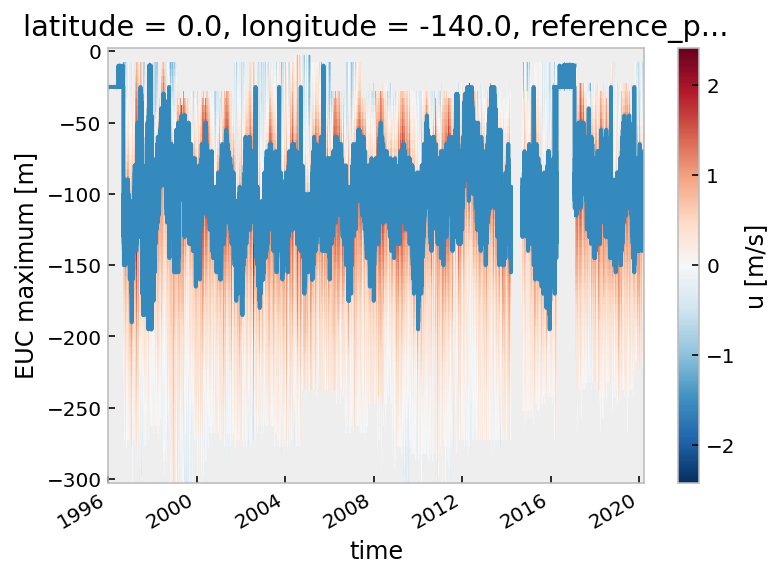

In [ ]:
tao_gridded.u.cf.plot()
tao_gridded.eucmax.plot()

### MITgcm stations

In [ ]:
stations = pump.model.read_stations_20(stationdirname)

gcmeq = stations.sel(
    longitude=[-155.025, -140.025, -125.025, -110.025], method="nearest"
)
# enso = pump.obs.make_enso_mask()
# mitgcm["enso"] = enso.reindex(time=mitgcm.time.data, method="nearest")

# gcmeq["eucmax"] = pump.calc.get_euc_max(gcmeq.u)
# pump.calc.calc_reduced_shear(gcmeq)

# oni = pump.obs.process_oni()
# gcmeq["enso_transition"] = mixpods.make_enso_transition_mask(oni).reindex(time=gcmeq.time.data, method="nearest")


mitgcm = gcmeq.sel(longitude=-140.025, method="nearest")
metrics = mixpods.normalize_z(pump.model.read_metrics(stationdirname), sort=True)
mitgcm = mixpods.normalize_z(mitgcm, sort=True)

mitgcm_grid = xgcm.Grid(
    metrics.sel(latitude=mitgcm.latitude, longitude=mitgcm.longitude, method="nearest"),
    coords=({"Z": {"center": "depth", "outer": "RF"}, "Y": {"center": "latitude"}}),
    metrics={"Z": ("drF", "drC")},
    periodic=False,
    boundary="fill",
    fill_value=np.nan,
)

mitgcm.theta.attrs["standard_name"] = "sea_water_potential_temperature"
mitgcm.salt.attrs["standard_name"] = "sea_water_salinity"
mitgcm["KPPviscAz"].attrs["standard_name"] = "ocean_vertical_viscosity"

In [ ]:
mitgcm = (
    mixpods.prepare(mitgcm, grid=mitgcm_grid, oni=pump.obs.process_oni())
    .sel(latitude=0, method="nearest")
    .cf.sel(Z=slice(-250, 0))
)

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/dask/array/core.py:4806: PerformanceWarning: Increasing number of chunks by factor of 37
  result = blockwise(


In [ ]:
mitgcm = xr.merge([mitgcm, mixpods.pdf_N2S2(mitgcm)])
mitgcm = mixpods.load(mitgcm)
mitgcm

<xarray.Dataset>
Dimensions:                (depth: 100, time: 174000, RF: 101, N2T_bins: 29,
                            S2_bins: 29, enso_transition_phase: 7, stat: 2,
                            N2_bins: 29, Rig_T_bins: 9)
Coordinates: (12/20)
  * depth                  (depth) float32 -248.8 -246.2 -243.8 ... -3.75 -1.25
    latitude               float64 0.025
    longitude              float64 -140.0
  * time                   (time) datetime64[ns] 1998-12-31T18:00:00 ... 2018...
  * RF                     (RF) float64 -250.0 -247.5 -245.0 ... -5.0 -2.5 0.0
    eucmax                 (time) float32 dask.array<chunksize=(162,), meta=np.ndarray>
    ...                     ...
  * S2_bins                (S2_bins) object [-5.0, -4.9) ... [-2.200000000000...
  * enso_transition_phase  (enso_transition_phase) object 'none' ... 'all'
  * stat                   (stat) object 'mean' 'count'
  * N2_bins                (N2_bins) object [-5.0, -4.9) ... [-2.200000000000...
    bin_areas              (N2T_bins, S2_bins) float64 0.01 0.01 ... 0.01 0.01
  * Rig_T_bins             (Rig_T_bins) object (-1.6, -1.4000000000000001] .....
Data variables: (12/31)
    DFrI_TH                (depth, time) float32 dask.array<chunksize=(100, 6000), meta=np.ndarray>
    KPPdiffKzT             (depth, time) float32 dask.array<chunksize=(100, 6000), meta=np.ndarray>
    KPPg_TH                (depth, time) float32 dask.array<chunksize=(100, 6000), meta=np.ndarray>
    KPPhbl                 (time) float32 dask.array<chunksize=(6000,), meta=np.ndarray>
    KPPviscAz              (depth, time) float32 dask.array<chunksize=(100, 6000), meta=np.ndarray>
    SSH                    (time) float32 dask.array<chunksize=(6000,), meta=np.ndarray>
    ...                     ...
    Rig_T                  (RF, time) float32 dask.array<chunksize=(100, 6000), meta=np.ndarray>
    Rig                    (RF, time) float32 dask.array<chunksize=(100, 6000), meta=np.ndarray>
    eps                    (RF, time) float32 dask.array<chunksize=(100, 6000), meta=np.ndarray>
    n2s2pdf                (N2T_bins, S2_bins, enso_transition_phase) float64 ...
    eps_n2s2               (stat, N2_bins, S2_bins, enso_transition_phase) float64 ...
    eps_ri                 (stat, Rig_T_bins, enso_transition_phase) float64 ...
Attributes:
    easting:   longitude
    northing:  latitude
    title:     Station profile, index (i,j)=(1201,240)

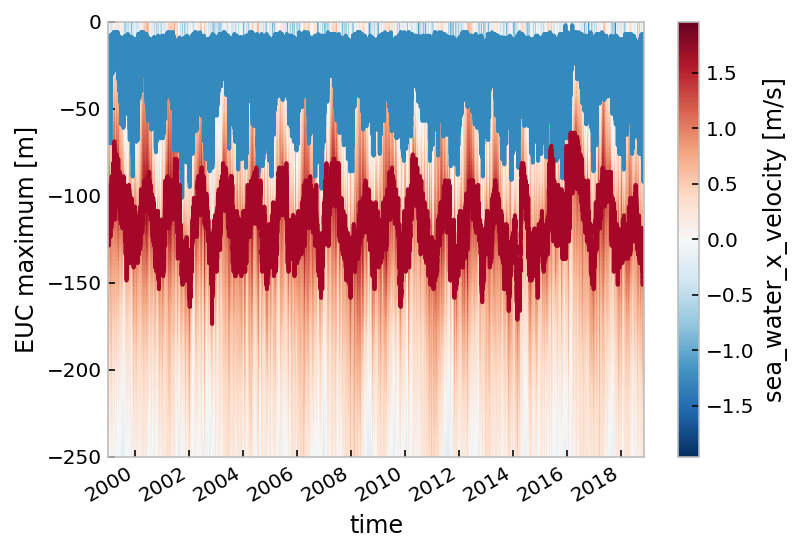

In [ ]:
mitgcm.u.cf.plot()
mitgcm.mldT.reset_coords(drop=True).cf.plot()
mitgcm.eucmax.reset_coords(drop=True).cf.plot()

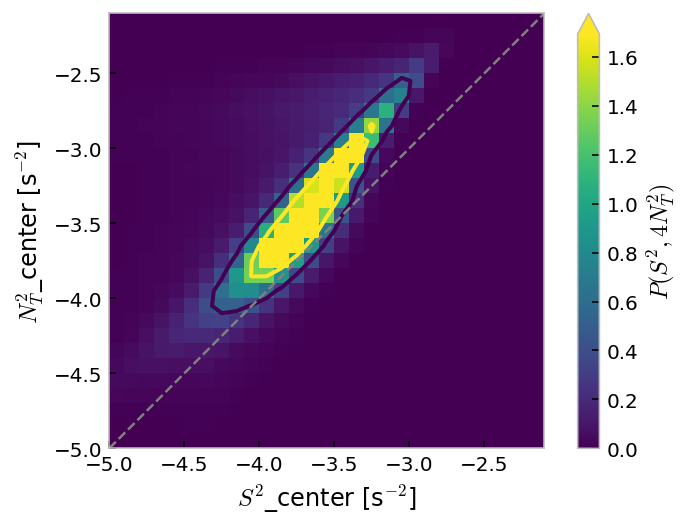

In [ ]:
mixpods.plot_n2s2pdf(mitgcm.n2s2pdf.sel(enso_transition_phase="none"))

### MOM6 

#### calculate ONI

In [ ]:
(
    oniobs.hvplot.line(x="time", label="obs")
    * onimom6.hvplot.line(x="time", label="MOM6")
).opts(ylabel="ONI [°C]")

:Overlay
   .Curve.Obs  :Curve   [time]   (index)
   .Curve.MOM6 :Curve   [time]   (tos)

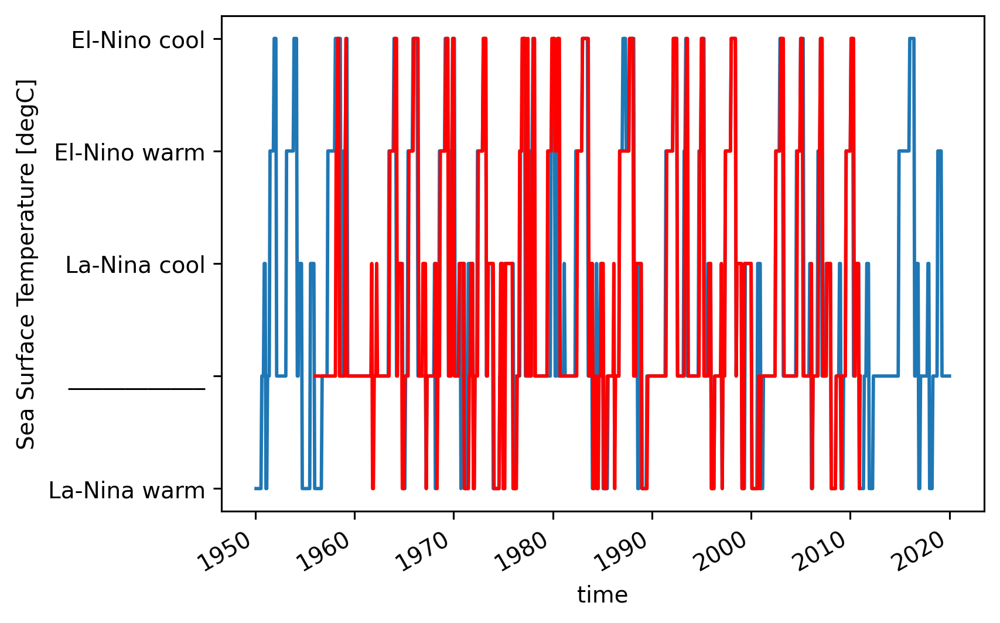

In [ ]:
oniobs.enso_transition_mask.plot()
onimom6.enso_transition_mask.plot(color="r")

#### MOM6 sections

##### Combine sections

In [ ]:
casename = "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixpods"
mixpods.mom6_sections_to_zarr(casename)

In [ ]:
casename = "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.epbl.001.mixpods"
mixpods.mom6_sections_to_zarr(casename)

100%|██████████| 31/31 [01:50<00:00,  3.57s/it]
/glade/u/home/dcherian/pump/pump/mixpods.py:887: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  mom6tao["time"] = mom6tao.indexes["time"].to_datetimeindex()


In [ ]:
casename = "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.kpp.lmd.002.mixpods"
mixpods.mom6_sections_to_zarr(casename)

In [ ]:
casename = "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.kpp.lmd.003.mixpods"
mixpods.mom6_sections_to_zarr(casename)

100%|██████████| 38/38 [02:07<00:00,  3.36s/it]
/glade/u/home/dcherian/pump/pump/mixpods.py:900: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  mom6tao["time"] = mom6tao.indexes["time"].to_datetimeindex()


In [ ]:
casename = "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.kpp.lmd.004.mixpods"
mixpods.mom6_sections_to_zarr(casename)

100%|██████████| 38/38 [02:06<00:00,  3.32s/it]
/glade/u/home/dcherian/pump/pump/mixpods.py:900: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  mom6tao["time"] = mom6tao.indexes["time"].to_datetimeindex()


#### Read sections

In [ ]:
dask.config.set(scheduler=client)
m = mixpods.read_mom6_sections(
    "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixpods"
)

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/dask_jobqueue/core.py:255: FutureWarning: job_extra has been renamed to job_extra_directives. You are still using it (even if only set to []; please also check config files). If you did not set job_extra_directives yet, job_extra will be respected for now, but it will be removed in a future release. If you already set job_extra_directives, job_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/dask_jobqueue/core.py:274: FutureWarning: env_extra has been renamed to job_script_prologue. You are still using it (even if only set to []; please also check config files). If you did not set job_script_prologue yet, env_extra will be respected for now, but it will be removed in a future release. If you already set job_script_prologue, env_extra is ignored and you can remove it.
  warnings.warn(warn, FutureWarning)
/glade/u/ho

In [ ]:
m.drop_vars(["average_DT", "average_T1", "average_T2", "time_bnds"]).chunk(
    {"time": 365 * 24}
).to_zarr(
    "/glade/scratch/dcherian/archive/gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixpods/ocn/moorings/tao.zarr",
    mode="w",
)

In [ ]:
m.sel(yh=0, method="nearest")[["ePBL_h_ML", "mlotst"]].to_array().hvplot.line(
    by="variable", x="time"
)

:DynamicMap   [xh]
   :NdOverlay   [variable]
      :Curve   [time]   (value)

In [ ]:
m.sel(yh=0, method="nearest")[["Kd_heat", "Kd_ePBL"]].to_array().hvplot.line(
    by="variable", groupby="time", logy=True, ylim=(1e-6, 1e-1), xlim=(0, 500)
)

:DynamicMap   [time]
   :NdOverlay   [variable]
      :Curve   [zi]   (value)

In [ ]:
mom6140 = mixpods.load_mom6_sections(casename).load()

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xgcm/grid.py:1471: UserWarning: Metric at ('time', 'zi', 'yh', 'xh') being interpolated from metrics at dimensions ('time', 'zl', 'yh', 'xh'). Boundary value set to 'extend'.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xgcm/grid.py:1471: UserWarning: Metric at ('time', 'zi', 'yh', 'xh') being interpolated from metrics at dimensions ('time', 'zl', 'yh', 'xh'). Boundary value set to 'extend'.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xgcm/grid.py:1471: UserWarning: Metric at ('time', 'zi', 'yq', 'xh') being interpolated from metrics at dimensions ('time', 'zl', 'yh', 'xh'). Boundary value set to 'extend'.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1638: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  war

In [ ]:
mom6140.uo.cf.plot(robust=True)
mom6140.eucmax.cf.plot()
mom6140.mldT.cf.plot(lw=0.5, color="k")

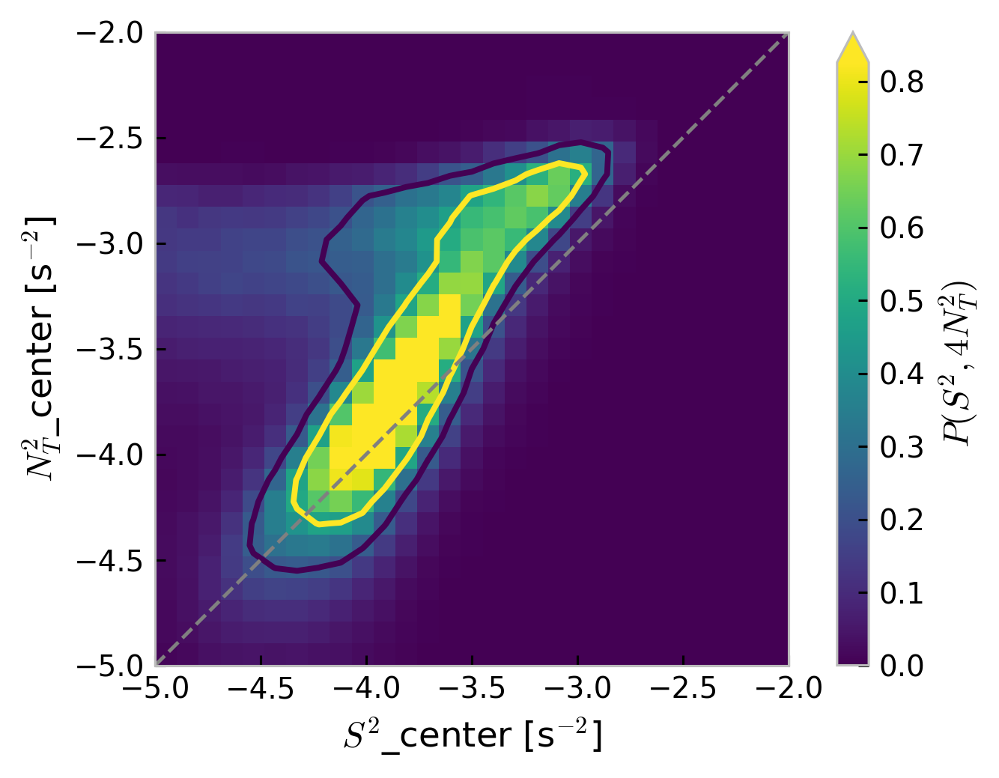

In [ ]:
mixpods.plot_n2s2pdf(mom6140.n2s2pdf.sel(enso_transition_phase="none"))

## Pick simulations

In [ ]:
baseline = mixpods.load_mom6_sections(
    "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixpods"
)

In [ ]:
epbl = mixpods.load_mom6_sections()

In [ ]:
import warnings

datasets = {
    "TAO": tao_gridded,
    # "MITgcm": mitgcm,
    # "MOM6 KPP": mixpods.load(baseline),
    # "MOM6 ePBL": mixpods.load(epbl),
}

with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=UserWarning)
    datasets.update(
        {
            short_name: mixpods.load_mom6_sections(folder).assign_attrs(
                {"title": long_name}
            )
            for short_name, (long_name, folder) in catalog.items()
        }
    )

In [ ]:
from datatree import DataTree

tree = DataTree.from_dict(
    {k: v.sel(time=slice("2000", "2017")) for k, v in datasets.items()}
)
ref = tree["TAO"].ds.reset_coords(drop=True).cf.sel(Z=slice(-120, None))
counts = np.minimum(ref["S2"].cf.count("Z"), ref["N2T"].cf.count("Z")).load()


def calc_histograms(ds):
    ds = ds.copy()
    ds["tao_mask"] = counts.reindex(time=ds.time, method="nearest") > 5
    ds["tao_mask"].attrs = {
        "description": "True when there are more than 5 5-m T, u, v in TAO dataset"
    }
    ds = ds.where(ds.tao_mask)
    return ds.update(mixpods.pdf_N2S2(ds))


tree = tree.map_over_subtree(calc_histograms)

In [ ]:
tree = mixpods.load_tree(tree)

## Verify depth is normalized

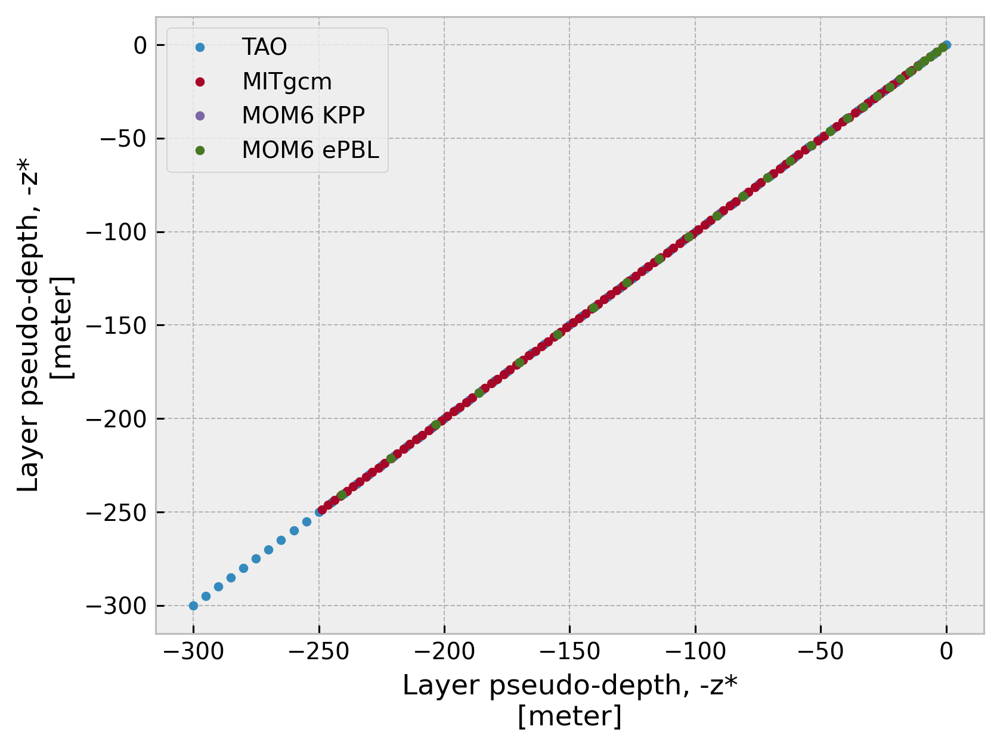

In [ ]:
for name, ds in datasets.items():
    (ds.cf["sea_water_x_velocity"].cf["Z"].plot(marker=".", ls="none", label=name))
plt.legend()

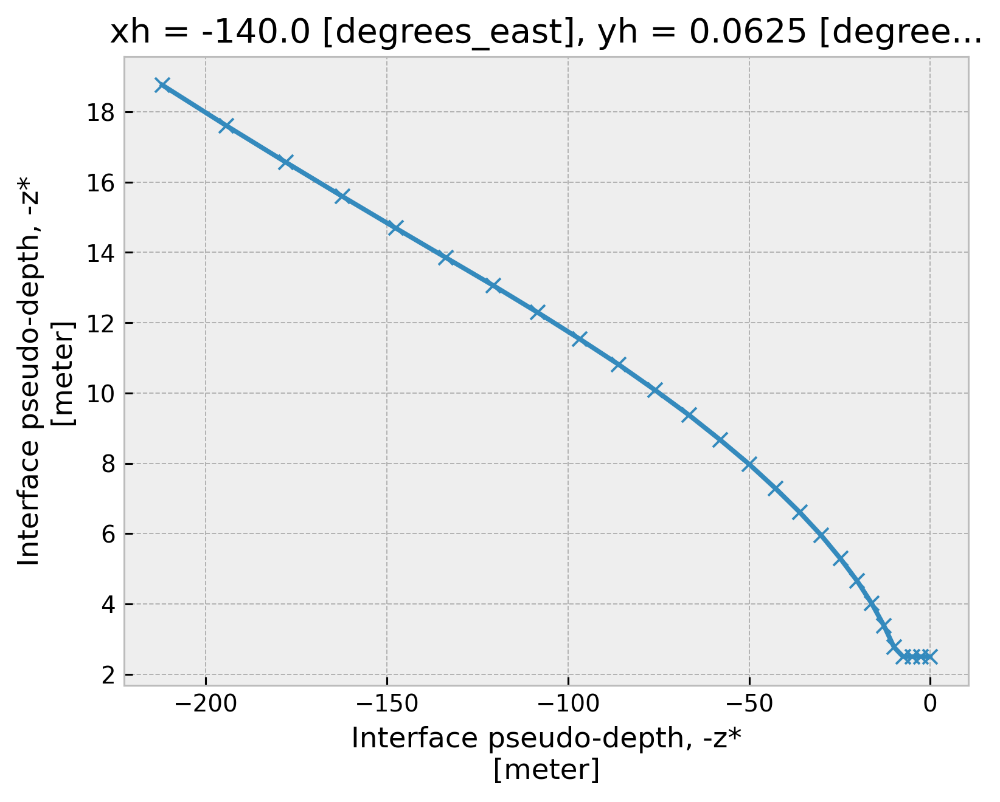

In [ ]:
baseline.zi.diff("zi").plot(marker="x")

## Compare EUC maximum and MLD

### Monthly climatology

In [ ]:
import tqdm

for node in tqdm.tqdm(tree.children):
    tree[node]["mldT"] = tree[node]["mldT"].load()

100%|██████████| 4/4 [00:52<00:00, 13.10s/it]


In [ ]:
def to_dataset(tree):
    concat = xr.concat([v.ds for v in tree.children.values()], dim="node")
    concat["node"] = list(tree.children.keys())
    return concat


clim = to_dataset(
    tree.map_over_subtree(
        lambda x: x.reset_coords()[["mldT", "eucmax"]].groupby("time.month").mean()
    )
).load()
clim

<xarray.Dataset>
Dimensions:  (node: 4, month: 12)
Coordinates:
  * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
  * node     (node) <U9 'TAO' 'MITgcm' 'MOM6 KPP' 'MOM6 ePBL'
Data variables:
    mldT     (node, month) float64 -28.23 -18.01 -14.84 ... -25.31 -32.05 -33.92
    eucmax   (node, month) float64 -108.0 -104.2 -95.85 ... -119.1 -120.1 -120.9

In [ ]:
hv.Layout(
    [
        hv.Overlay(
            [
                tree[node]
                .ds["mldT"]
                .reset_coords(drop=True)
                .groupby("time.month")[month]
                .hvplot.hist(label=node, legend=True)
                .opts(frame_width=150)
                for node in tree.children
            ]
        ).opts(title=str(month))
        for month in np.arange(1, 13)
    ]
).cols(4)

:Layout
   .Overlay.I    :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.II   :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.III  :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.IV   :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.V    :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.VI   :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.VII  :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.VIII :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.IX   :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
   .Overlay.X    :Overlay
      .NdOverlay.TAO       :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MITgcm    :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_KPP  :NdOverlay   [Element]
         :Histogram   [mldT]   (mldT_count)
      .NdOverlay.MOM6_ePBL :NdOverlay   [Element]
         :Histog

In [ ]:
(clim.mldT.hvplot(by="node") + clim.eucmax.hvplot(by="node")).cols(1)

:Layout
   .NdOverlay.I  :NdOverlay   [node]
      :Curve   [month]   (mldT)
   .NdOverlay.II :NdOverlay   [node]
      :Curve   [month]   (eucmax)

In [ ]:
mixpods.plot_timeseries(tree, "mldT", obs="TAO")

:Overlay
   .Curve.TAO       :Curve   [time]   (mldT)
   .Curve.MITgcm    :Curve   [time]   (mldT)
   .Curve.MOM6_KPP  :Curve   [time]   (mldT)
   .Curve.MOM6_ePBL :Curve   [time]   (mldT)

In [ ]:
datasets["TAO"].eucmax.attrs["long_name"] = "EUC maximum"
mixpods.plot_timeseries(tree.sel(time="2008"), "eucmax", obs="TAO")

:Overlay
   .Curve.TAO       :Curve   [time]   (eucmax)
   .Curve.MITgcm    :Curve   [time]   (eucmax)
   .Curve.MOM6_KPP  :Curve   [time]   (eucmax)
   .Curve.MOM6_ePBL :Curve   [time]   (eucmax)

## MLD Maps

In [ ]:
def read_sfc(casename):
    path = f"/glade/scratch/dcherian/archive/{casename}/ocn/hist/*sfc*00[4-7]*.nc"
    sfc = xr.open_mfdataset(
        path, data_vars="minimal", coords="minimal", compat="override", parallel=True
    )
    return sfc


sfc = DataTree()
casenames = {
    "MOM6 KPP": "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixpods",
    "MOM6 ePBL": "gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.epbl.001.mixpods",
}

for name, casename in casenames.items():
    sfc[name] = DataTree(read_sfc(casename))

In [ ]:
sfc

DataTree('None', parent=None)
├── DataTree('MOM6 KPP')
│       Dimensions:       (xh: 540, yh: 458, time: 10154, nv: 2, xq: 540, yq: 458)
│       Coordinates:
│         * xh            (xh) float64 -286.7 -286.0 -285.3 -284.7 ... 71.33 72.0 72.67
│         * yh            (yh) float64 -79.2 -79.08 -78.95 -78.82 ... 87.64 87.71 87.74
│         * time          (time) object 0004-01-01 12:00:00 ... 0063-12-05 12:00:00
│         * nv            (nv) float64 1.0 2.0
│         * xq            (xq) float64 -286.3 -285.7 -285.0 -284.3 ... 71.67 72.33 73.0
│         * yq            (yq) float64 -79.14 -79.01 -78.89 -78.76 ... 87.68 87.73 87.74
│       Data variables: (12/16)
│           SSH           (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           tos           (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           sos           (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           SSU           (time, yh, xq) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           SSV           (time, yq, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           mass_wt       (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           ...            ...
│           mlotst        (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           oml           (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
│           average_T1    (time) object dask.array<chunksize=(31,), meta=np.ndarray>
│           average_T2    (time) object dask.array<chunksize=(31,), meta=np.ndarray>
│           average_DT    (time) timedelta64[ns] dask.array<chunksize=(31,), meta=np.ndarray>
│           time_bnds     (time, nv) timedelta64[ns] dask.array<chunksize=(31, 2), meta=np.ndarray>
│       Attributes:
│           filename:          gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixp...
│           title:             MOM6 diagnostic fields table for CESM case: gmom.e23.G...
│           associated_files:  areacello: gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseli...
│           grid_type:         regular
│           grid_tile:         N/A
└── DataTree('MOM6 ePBL')
        Dimensions:     (xh: 540, yh: 458, time: 8355, nv: 2, xq: 540, yq: 458)
        Coordinates:
          * xh          (xh) float64 -286.7 -286.0 -285.3 -284.7 ... 71.33 72.0 72.67
          * yh          (yh) float64 -79.2 -79.08 -78.95 -78.82 ... 87.64 87.71 87.74
          * time        (time) object 0040-01-01 12:00:00 ... 0062-12-31 12:00:00
          * nv          (nv) float64 1.0 2.0
          * xq          (xq) float64 -286.3 -285.7 -285.0 -284.3 ... 71.67 72.33 73.0
          * yq          (yq) float64 -79.14 -79.01 -78.89 -78.76 ... 87.68 87.73 87.74
        Data variables:
            SSH         (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
            tos         (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
            sos         (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
            SSU         (time, yh, xq) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
            SSV         (time, yq, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
            speed       (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
            mlotst      (time, yh, xh) float32 dask.array<chunksize=(31, 458, 540), meta=np.ndarray>
            average_T1  (time) object dask.array<chunksize=(31,), meta=np.ndarray>
            average_T2  (time) object dask.array<chunksize=(31,), meta=np.ndarray>
            average_DT  (time) timedelta64[ns] dask.array<chunksize=(31,), meta=np.ndarray>
            time_bnds   (time, nv) timedelta64[ns] dask.array<chunksize=(31, 2), meta=np.ndarray>
        Attributes:
            filename:          gmom.e23

In [ ]:
mldclim = sfc.map_over_subtree(
    lambda node: node.mlotst.groupby("time.month").mean()
).compute()

In [ ]:
filepath = (
    "/glade/work/gmarques/cesm/datasets/MLD/deBoyer/deBoyer_MLD_remapped_to_tx06v1.nc"
)
mldclim["obs"] = DataTree(xr.open_dataset(filepath))
mldclim

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/coding/times.py:699: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/core/indexing.py:524: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  return np.asarray(array[self.key], dtype=None)


DataTree('None', parent=None)
├── DataTree('MOM6 KPP')
│       Dimensions:  (xh: 540, yh: 458, month: 12)
│       Coordinates:
│         * xh       (xh) float64 -286.7 -286.0 -285.3 -284.7 ... 70.67 71.33 72.0 72.67
│         * yh       (yh) float64 -79.2 -79.08 -78.95 -78.82 ... 87.55 87.64 87.71 87.74
│         * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
│       Data variables:
│           mlotst   (month, yh, xh) float32 nan nan nan nan nan ... nan nan nan nan nan
├── DataTree('MOM6 ePBL')
│       Dimensions:  (xh: 540, yh: 458, month: 12)
│       Coordinates:
│         * xh       (xh) float64 -286.7 -286.0 -285.3 -284.7 ... 70.67 71.33 72.0 72.67
│         * yh       (yh) float64 -79.2 -79.08 -78.95 -78.82 ... 87.55 87.64 87.71 87.74
│         * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
│       Data variables:
│           mlotst   (month, yh, xh) float32 nan nan nan nan nan ... nan nan nan nan nan
└── DataTree('obs')
        Dimensions:  (time: 12, yh: 458, xh: 540)
        Coordinates:
          * time     (time) object 0001-01-15 12:00:00 ... 0001-12-15 12:00:00
          * yh       (yh) float64 -79.2 -79.08 -78.95 -78.82 ... 87.55 87.64 87.71 87.74
          * xh       (xh) float64 -286.7 -286.0 -285.3 -284.7 ... 70.67 71.33 72.0 72.67
        Data variables:
            mld      (time, yh, xh) float64 ...
        Attributes:
            author:       Gustavo Marques (gmarques@ucar.edu)
            description:  MLD using density criterion of 0.03 kg/m3 difference (de Bo...

In [ ]:
mldclim.

In [ ]:
mldclim["MOM6 KPP"] = DataTree(
    read_sfc("gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.001.mixpods")
    .mlotst.groupby("time.month")
    .mean()
)

In [ ]:
mldclim["MOM6 ePBL"] = DataTree(
    read_sfc("gmom.e23.GJRAv3.TL319_t061_zstar_N65.baseline.epbl.001.mixpods")
    .mlotst.groupby("time.month")
    .mean()
)

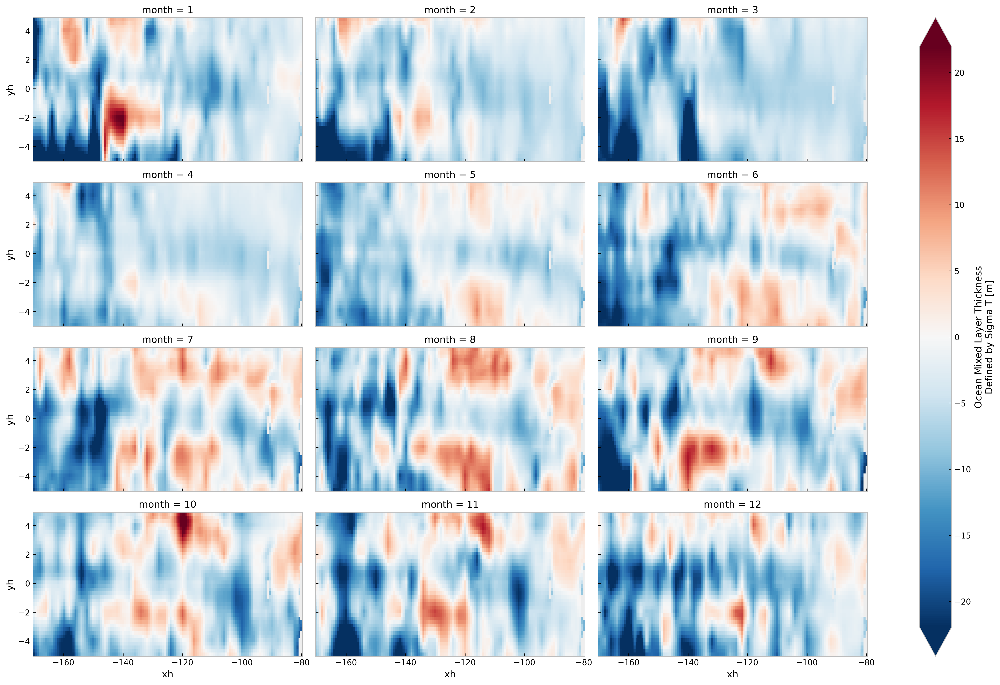

In [ ]:
(
    (mlotst - mldclim.mld.groupby("time.month").first())
    .sel(yh=slice(-5, 5), xh=slice(-170, -80))
    .plot(col="month", robust=True, col_wrap=3, aspect=2)
)

## Mixing layer depth?

In [ ]:
todrop = ["TAO"]
notao = DataTree.from_dict(
    {k: v.ds for k, v in tree.children.items() if k not in todrop}
)
with cfxr.set_options(custom_criteria=mixing_layer_criteria):
    plot = mixpods.plot_timeseries(notao, "boundary_layer_depth", obs=None)
plot

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(


:Overlay
   .Curve.MITgcm    :Curve   [time]   (KPPhbl)
   .Curve.MOM6_KPP  :Curve   [time]   (KPP_OBLdepth)
   .Curve.MOM6_ePBL :Curve   [time]   (ePBL_h_ML)

## Mean profiles: mean, std


Model mean S2 is lower by a factor of 2

In [ ]:
tree = tree.assign(
    dTdz=lambda ds: ds.cf["sea_water_potential_temperature"]
    .reset_coords(drop=True)
    .cf.differentiate("Z")
    .load()
)
tree = tree.assign(
    dSdz=lambda ds: ds.cf["sea_water_salinity"]
    .reset_coords(drop=True)
    .cf.differentiate("Z")
    .load()
)
tree = tree.assign({"4N2T": lambda ds: 4 * ds.N2T.load()})

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(


In [ ]:
kwargs = dict(
    show_grid=True,
    title="",
    invert_axes=True,
    legend_position="right",
    frame_width=150,
    frame_height=500,
)

limkwargs = dict(
    ylim=(-1e-3, 1.9e-3),
    xlim=(-250, 0),
)


def plot_profile_fill(datasets, var, label):
    from datatree import DataTree

    if isinstance(datasets, DataTree):
        datasets = datasets.children
    return mixpods.map_hvplot(
        lambda ds, name: mixpods.plot_profile_fill(ds.ds.cf[var].load(), name), datasets
    ).opts(**kwargs, ylabel=label)


S2 = plot_profile_fill(tree, "S2", "S^2")
N2 = plot_profile_fill(tree, "N2T", "N_T^2")
Ri = (
    (
        mixpods.map_hvplot(
            lambda ds, name: mixpods.cfplot(ds.Rig_T.load().median("time"), name),
            datasets,
        )
        * hv.HLine(0.25).opts(color="k", line_width=0.5)
    )
    .opts(**kwargs, **limkwargs, ylabel="median Ri_g^T")
    .opts(ylim=(0, 1))
)

In [ ]:
(S2 + N2 + Ri).opts(sizing_mode="stretch_width")

:Layout
   .Overlay.I   :Overlay
      .Area.I          :Area   [depth]   (low,high)
      .Curve.TAO       :Curve   [depth]   (S2)
      .Area.II         :Area   [RF]   (low,high)
      .Curve.MITgcm    :Curve   [RF]   (S2)
      .Area.III        :Area   [zi]   (low,high)
      .Curve.MOM6_KPP  :Curve   [zi]   (S2)
      .Area.IV         :Area   [zi]   (low,high)
      .Curve.MOM6_ePBL :Curve   [zi]   (S2)
   .Overlay.II  :Overlay
      .Area.I          :Area   [depth]   (low,high)
      .Curve.TAO       :Curve   [depth]   (N2T)
      .Area.II         :Area   [RF]   (low,high)
      .Curve.MITgcm    :Curve   [RF]   (N2T)
      .Area.III        :Area   [zi]   (low,high)
      .Curve.MOM6_KPP  :Curve   [zi]   (N2T)
      .Area.IV         :Area   [zi]   (low,high)
      .Curve.MOM6_ePBL :Curve   [zi]   (N2T)
   .Overlay.III :Overlay
      .Curve.TAO       :Curve   [depth]   (Rig_T)
      .Curve.MITgcm    :Curve   [RF]   (Rig_T)
      .Curve.MOM6_KPP  :Curve   [zi]   (Rig_T)
      .Curve.MOM6_ePBL :Curve   [zi]   (Rig_T)
      .HLine.I         :HLine   [x,y]

In [ ]:
T = plot_profile_fill(tree, "sea_water_potential_temperature", "T")
S = plot_profile_fill(tree, "sea_water_salinity", "S")
u = plot_profile_fill(tree, "sea_water_x_velocity", "u")
# dTdz = plot_profile_fill(tree, "dTdz", "∂T/∂z")
# dSdz = plot_profile_fill(tree, "dSdz", "∂S/∂z")

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(
/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/cf_xarray/accessor.py:1663: UserWarning: Variables {'areacello'} not found in object but are referred to in the CF attributes.
  warnings.warn(


In [ ]:
(T + S + u.opts(ylim=(-0.5, 1.5))).opts(sizing_mode="stretch_width")

:Layout
   .Overlay.I   :Overlay
      .Area.I          :Area   [depth]   (theta_low,theta_high)
      .Curve.TAO       :Curve   [depth]   (theta)
      .Area.II         :Area   [depth]   (theta_low,theta_high)
      .Curve.MITgcm    :Curve   [depth]   (theta)
      .Area.III        :Area   [zl]   (thetao_low,thetao_high)
      .Curve.MOM6_KPP  :Curve   [zl]   (thetao)
      .Area.IV         :Area   [zl]   (thetao_low,thetao_high)
      .Curve.MOM6_ePBL :Curve   [zl]   (thetao)
   .Overlay.II  :Overlay
      .Area.I          :Area   [depth]   (S_low,S_high)
      .Curve.TAO       :Curve   [depth]   (S)
      .Area.II         :Area   [depth]   (salt_low,salt_high)
      .Curve.MITgcm    :Curve   [depth]   (salt)
      .Area.III        :Area   [zl]   (so_low,so_high)
      .Curve.MOM6_KPP  :Curve   [zl]   (so)
      .Area.IV         :Area   [zl]   (so_low,so_high)
      .Curve.MOM6_ePBL :Curve   [zl]   (so)
   .Overlay.III :Overlay
      .Area.I          :Area   [depth]   (u_low,u_high)
      .Curve.TAO       :Curve   [depth]   (u)
      .Area.II         :Area   [depth]   (u_low,u_high)
      .Curve.MITgcm    :Curve   [depth]   (u)
      .Area.III        :Area   [zl]   (uo_low,uo_high)
      .Curve.MOM6_KPP  :Curve   [zl]   (uo)
      .Area.IV         :Area   [zl]   (uo_low,uo_high)
      .Curve.MOM6_ePBL :Curve   [zl]   (uo)

## Remap to EUC coordinate

In [ ]:
gcmeq.coords["zeuc"] = gcmeq.depth - gcmeq.eucmax
remapped = flox.xarray.xarray_reduce(
    gcmeq.drop_vars(["SSH", "KPPhbl", "mld", "eucmax"], errors="ignore"),
    "zeuc",
    dim="depth",
    func="mean",
    expected_groups=(np.arange(-250, 250.1, 5),),
    isbin=(True,),
)
remapped["zeuc_bins"].attrs["units"] = "m"
remapped

<xarray.Dataset>
Dimensions:          (time: 174000, longitude: 4, zeuc_bins: 100)
Coordinates:
    latitude         float64 0.025
  * longitude        (longitude) float64 -155.0 -140.0 -125.0 -110.0
  * time             (time) datetime64[ns] 1998-12-31T18:00:00 ... 2018-11-06...
    cool_mask        (time) bool True True True True ... False False False False
    warm_mask        (time) bool False False False False ... True True True True
  * zeuc_bins        (zeuc_bins) object (-250.0, -245.0] ... (245.0, 250.0]
Data variables: (12/25)
    DFrI_TH          (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    KPPdiffKzT       (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    KPPg_TH          (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    KPPviscAz        (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    VISrI_Um         (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    VISrI_Vm         (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    ...               ...
    S2               (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    shear            (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    N2               (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    shred2           (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    Ri               (time, longitude, zeuc_bins) float32 dask.array<chunksize=(6000, 1, 100), meta=np.ndarray>
    enso_transition  (zeuc_bins, time) <U12 'La-Nina cool' ... 'El-Nino warm'
Attributes:
    easting:   longitude
    northing:  latitude
    title:     Station profile, index (i,j)=(1201,240)

In [ ]:
remapped = remapped.persist()

In [ ]:
cluster.scale(6)

## Seasonal median Ri: (0, 140)

In [ ]:
remapped["longitude"] = [-155.0, -140, -125, -110]

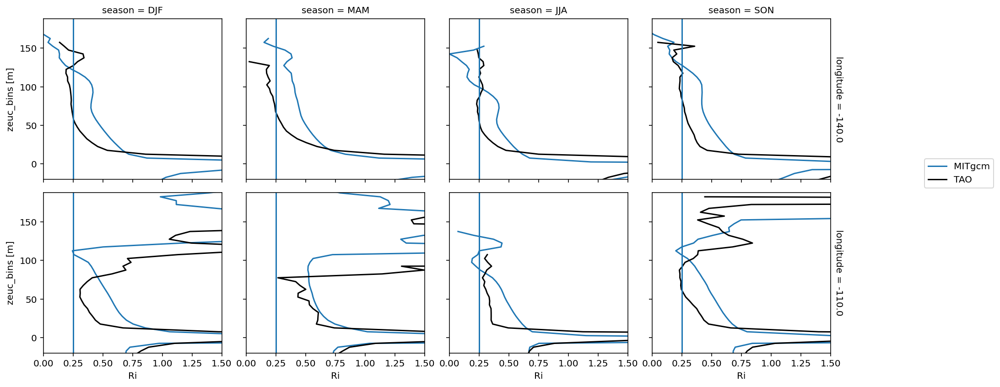

In [ ]:
fg = (
    remapped.Ri.groupby("time.season")
    .median()
    .sel(season=["DJF", "MAM", "JJA", "SON"], longitude=[-140, -110])
    .cf.plot(
        col="season", row="longitude", xlim=(0, 1.5), ylim=(-20, None), label="MITgcm"
    )
)
fg.data = tao_Ri.cf.sel(quantile=0.5, longitude=[-140, -110])
fg.map_dataarray_line(
    xr.plot.line, x=None, y="zeuc", hue="season", color="k", label="TAO"
)
fg.map(lambda: plt.axvline(0.25))
fg.axes[-1, -1].legend(bbox_to_anchor=(1.5, 1))

## Stability diagram: 4N2-S2 plane

Warner & Moum (2019):
> Both velocity and temperature are hourly averaged before interpolation to 5-m vertical bins

Contours enclose 50% of data

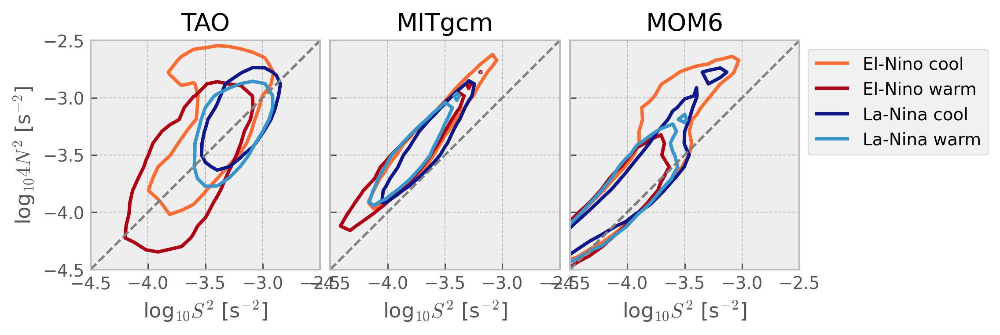

In [ ]:
mixpods.plot_stability_diagram_by_dataset(datasets)

Questions:
1. internal wave spectrum?
2. minor axis is smaller for model, particularly MITgcm-> too diffusive? 
3. Can we think of this as the model relaxing to critical Ri too quickly

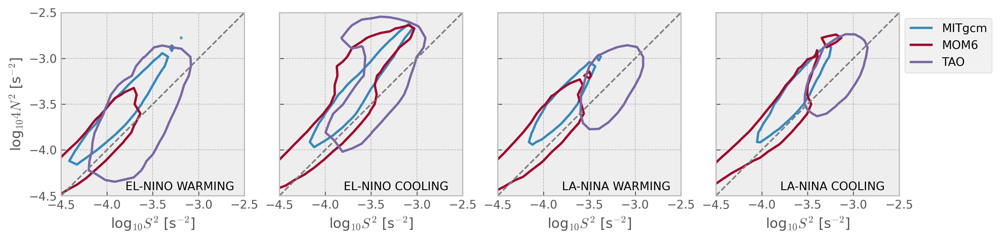

In [ ]:
mixpods.plot_stability_diagram_by_phase(datasets, obs="TAO", fig=None)

### Composed

#### excluding MLD

- have not matched vertical grid spacing yet.
- minor axis is smaller for increasing shear with KPP
- prandtl number
- interpolate to TAO grid
- hybrid HYCOM-like case may have equatorial refinement of vertical grid above EUC
- compare hybrid coordinate case resolution
- instrumental error on vertical gradients for S2, N2;
    - if added to model, would it change the bottom tail.
- Horizontal or vertical res:
    - MOM6 at 5km? hah
    - TIW compositing? La-NIna dec?
        - top end's are similar, so maybe not?

- sensitivity of cold tongue mean state
    - horizontal viscosity; controls EUC strength? (increase?)
    - vertical res; yan li's paper
    - POP :thermocline always too diffuse and EUC too thick;
    - higher order interpolants can control amount diffusion when remapping
    
    
- get S2, N2 from TPOSE?

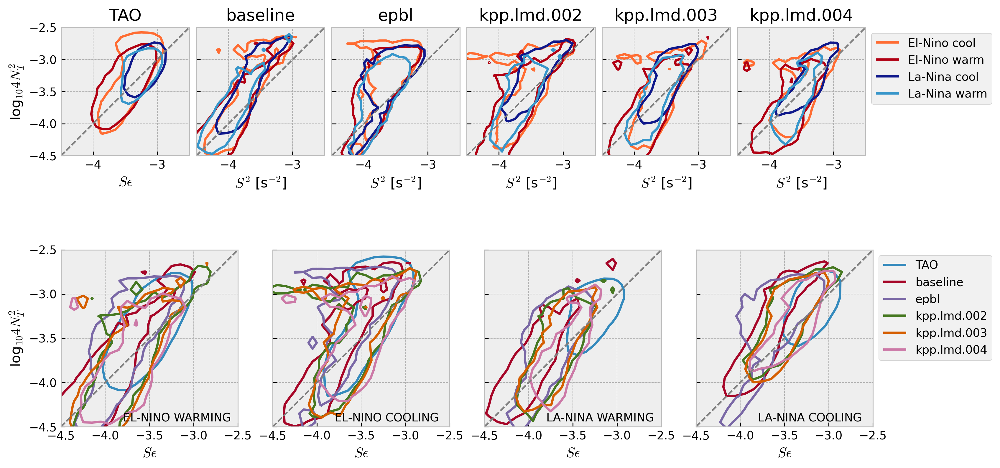

In [ ]:
fig = plt.figure(constrained_layout=True, figsize=(12, 6))

subfigs = fig.subfigures(2, 1)
mixpods.plot_stability_diagram_by_dataset(tree, fig=subfigs[0])
mixpods.plot_stability_diagram_by_phase(tree, fig=subfigs[1])

#### including MLD

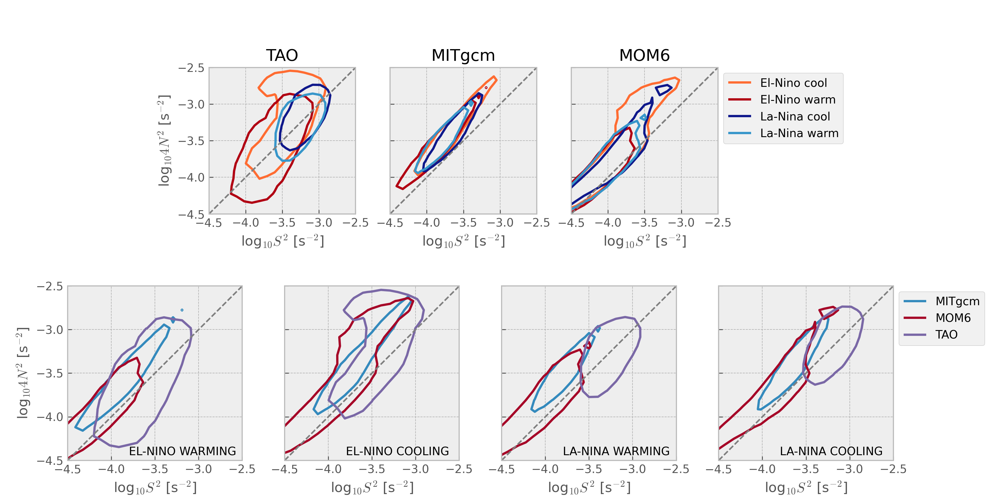

In [ ]:
fig = plt.figure(constrained_layout=True, figsize=(12, 6))
subfigs = fig.subfigures(2, 1, height_ratios=[1.2, 1])
top = subfigs[0].subfigures(1, 3, width_ratios=[1, 5, 1])

mixpods.plot_stability_diagram_by_dataset(datasets, fig=top[1])
mixpods.plot_stability_diagram_by_phase(datasets, fig=subfigs[1])

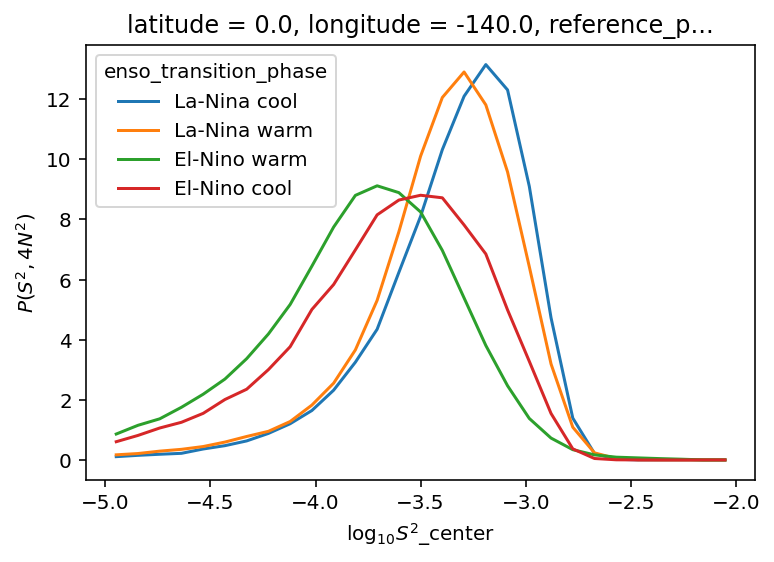

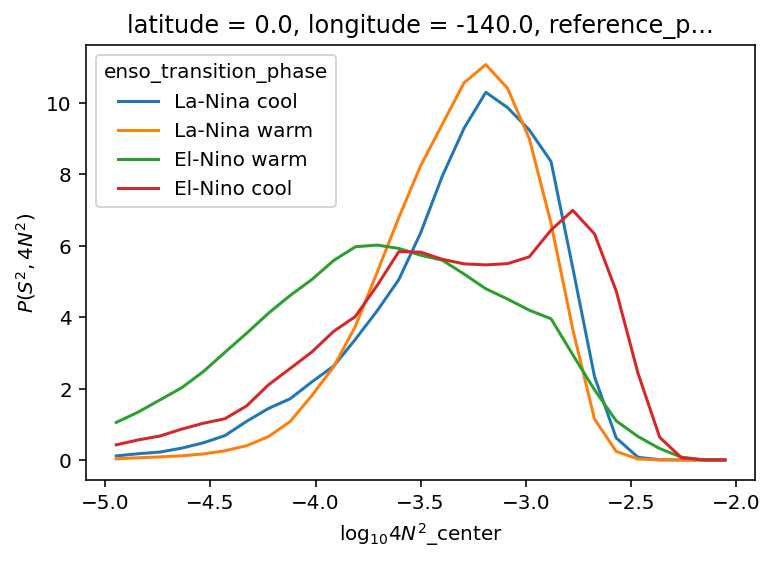

In [ ]:
(
    tao_gridded.n2s2pdf.sel(
        enso_transition_phase=[
            "La-Nina cool",
            "La-Nina warm",
            "El-Nino warm",
            "El-Nino cool",
        ]
    )
    .sum("N2_bins")
    .plot(hue="enso_transition_phase")
)
plt.figure()
(
    tao_gridded.n2s2pdf.sel(
        enso_transition_phase=[
            "La-Nina cool",
            "La-Nina warm",
            "El-Nino warm",
            "El-Nino cool",
        ]
    )
    .sum("S2_bins")
    .plot(hue="enso_transition_phase")
)

In [ ]:
oni = pump.obs.process_oni().sel(time=slice("2005-Oct", "2015"))
(
    oni.hvplot.step(color="k")
    + pump.obs.make_enso_transition_mask()
    .sel(time=slice("2005-Jun", "2015"))
    .reset_coords(drop=True)
    .hvplot.step()
).cols(1)

:Layout
   .Curve.I  :Curve   [time]   (index)
   .Curve.II :Curve   [time]   (enso_phase)

## ε Ri TAO check

In [ ]:
data = tao_gridded.drop_vars("zeuc")
epsZ = data.eps.cf["Z"].cf.sel(Z=slice(-69, -29))

# χpod data are available at a subset of depths
Ri = np.log10(mixpods.reindex_Z_to(data.Rig_T, epsZ))
# Ri_bins = np.logspace(np.log10(0.025), np.log10(2), 11)
Ri_bins = np.arange(-1.6, 0.4, 0.2)  # in log space from Sally
# Ri_bins = np.array([0.02, 0.04, 0.06, 0.1, 0.3, 0.5, 0.7, 1.5, 2])
Ri_kwargs = {
    "expected_groups": (Ri_bins, None),
    "isbin": (True, False),
}

In [ ]:
mpl.rcParams["figure.dpi"] = 120

In [ ]:
(
    data.eps.count("depthchi").hvplot.line(x="time")
    + Ri.count("depthchi").hvplot.line(x="time")
).cols(1)

:Layout
   .Curve.I  :Curve   [time]   (eps)
   .Curve.II :Curve   [time]   (Rig_T)

In [ ]:
data = tao_gridded.eps_n2s2.sel(
    enso_transition_phase=[
        "El-Nino warm",
        "La-Nina warm",
        "El-Nino cool",
        "La-Nina cool",
    ]
)

fg = data.to_dataset("stat").plot.scatter(
    x="S2_bins",
    y="N2_bins",
    hue="mean",  # markersize="count",
    col="enso_transition_phase",
    col_wrap=2,
    norm=mpl.colors.LogNorm(1e-7, 1e-6),
    cmap=mpl.cm.Greys,
    robust=True,
    xlim=(-4.5, -2.5),
    ylim=(-4.5, -2.5),
)
fg.set_titles("{value}")

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/plot/plot.py:454: UserWarning: The handle <matplotlib.lines.Line2D object at 0x2aea35fc2b00> has a label of '____________' which cannot be automatically added to the legend.
  ax.legend(handles=primitive, labels=list(hueplt.to_numpy()), title=hue_label)


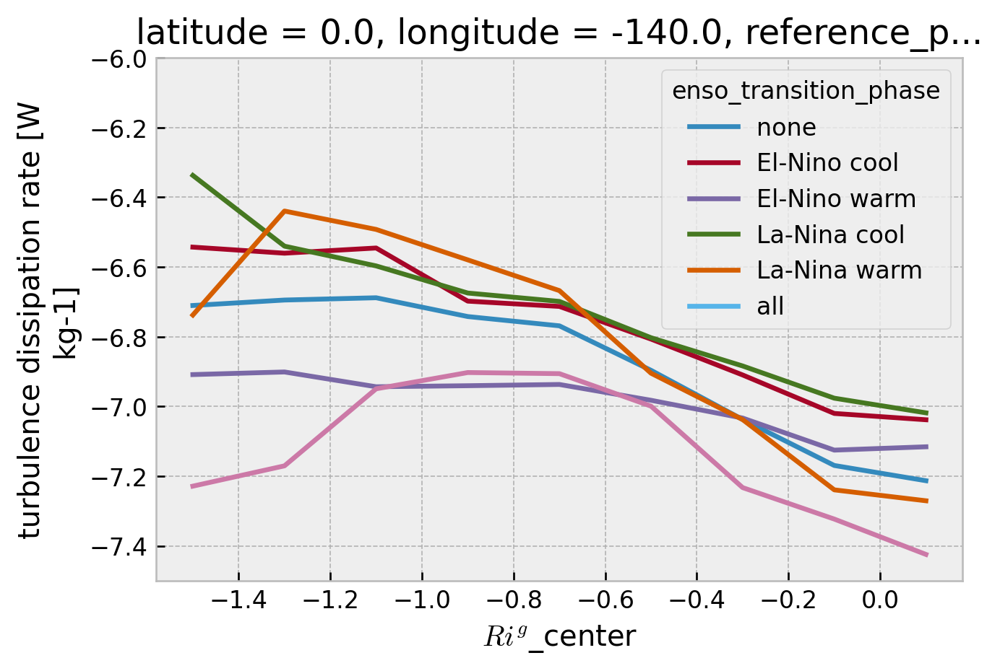

In [ ]:
np.log10(tao_gridded.eps_ri).sel(stat="mean").plot(
    hue="enso_transition_phase", ylim=(-7.5, -6)
)

## Turbulence

### Dan's suggestions

1. I liked your effort to look at shear production= KmdU/dz dot dU/dz = dissipation.  I mentioned that it might be worth looking at `buoyancy flux = KT dT/dz * db/dT + KS dS/dz * db/dS` with db/dT, db/dS from equation of state. I think I said KT*N^2, but I hope after checking that this is the same in this region (K_T~K_S). You could then divide buoyancy flux by 0.2 to estimate epsilon for comparison with your estimate based on shear production.

 

2. Dimensionless parameters. We alluded to this, but I think it would be interesting to explicitly quantify flux Richardson number Rif= buoyancy flux/shear production (as defined above). And Prt=KT/Km=Rif/Rig, where Rig is the usual gradient Richardson number. Following a similar logic, you might look at Reb= epsilon/nu N^2 with nu constant 1e-6 molecular viscosity. We discussed looking at diffusivity and viscosity in addition to epsilon. But note the similarity between dimensionless diffusivity KT/kappa and viscosity Km/nu, i.e. Reb=Rig*KM/nu. (with kappa a constant molecular diffusivity to make dimensionless)

 

3. I like how you continue to push what we can learn from the distributions in S2-N2 parameter space in addition to physical space. It is good for comparing with limited observations or process models. I think you can push this even further to develop metrics quantifying how the momentum and buoyancy fluxes “tango” with each other and with S2 and N2. In addition, perhaps it would be valuable to flip the perspective and look at shear-production-buoyancy flux space? Or consider various two-dimensional spaces of non-dimensional parameters mentioned above: Rig, Reb, Rif, KT/kappa, Km/nu. 

 

4. Finally, I think it would be interesting to try to examine how momentum flux and shear production below the mixed layer relate to wind stress as well as the local shear. There might be a relationship that emerges in KPP, even if the K profile is formally dependent only on local Rig at these depths.

In [ ]:
(
    np.log10(np.abs(baseline.Rif.cf.sel(Z=slice(-110, 0))))
    .reset_coords(drop=True)
    .hvplot.hist(bins=np.linspace(-2, 1, 100))
) * hv.VLine(np.log10(0.2)).opts(line_color="k")

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/core/computation.py:771: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


:Overlay
   .NdOverlay.I :NdOverlay   [Element]
      :Histogram   [Rif]   (Rif_count)
   .VLine.I     :VLine   [x,y]

In [ ]:
from xhistogram.xarray import histogram

In [ ]:
jpdf = histogram(
    np.log10(baseline.eps),
    np.log10(0.2 * baseline.eps_Jb),
    density=True,
    bins=np.linspace(-10, -4, 100),
).compute()

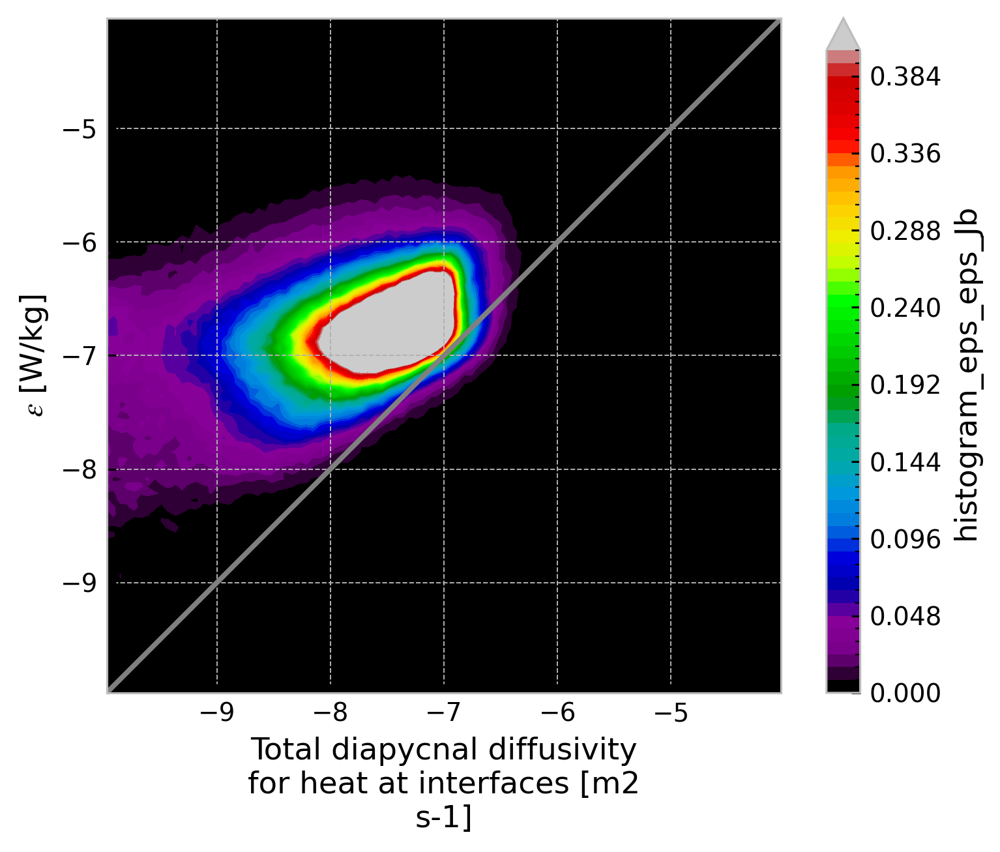

In [ ]:
jpdf.plot.contourf(levels=52, robust=True, cmap=mpl.cm.nipy_spectral)
dcpy.plots.line45()

In [ ]:
from mom6_tools import wright_eos

In [ ]:
mom6tao = baseline
mom6tao["α"] = wright_eos.alpha_wright_eos(mom6tao.thetao, mom6tao.so, p=0)
mom6tao["α"].attrs = {
    "standard_name": "sea_water_thermal_expansion_coefficient",
    "units": "kg m-3 C-1",
}
mom6tao["β"] = wright_eos.beta_wright_eos(mom6tao.thetao, mom6tao.so, p=0)
mom6tao["β"].attrs = {
    "standard_name": "sea_water_haline_contraction_coefficient",
    "units": "kg m-3",
}

In [ ]:
(
    baseline.Kd_heat * baseline.α * baseline.Tz
    + baseline.Kd_heat * baseline.β * baseline.Sz
)

<xarray.DataArray (time: 507264, zi: 27, zl: 27)>
dask.array<chunksize=(8760, 26, 27), meta=np.ndarray>
Coordinates: (12/14)
  * time             (time) datetime64[ns] 1958-01-06T00:30:00 ... 2016-12-31...
    xh               float64 -140.0
    yh               float64 0.0625
    yq               float64 -0.0625
  * zi               (zi) float64 -230.8 -212.0 -194.4 -177.8 ... -5.0 -2.5 -0.0
    eucmax           (time) float64 dask.array<chunksize=(8760,), meta=np.ndarray>
    ...               ...
    en_mask          (time) bool False False False False ... False False False
    ln_mask          (time) bool False False False False ... False False False
    warm_mask        (time) bool True True True True ... True True True True
    cool_mask        (time) bool False False False False ... False False False
    enso_transition  (time) <U12 '____________' ... '____________'
  * zl               (zl) float64 -240.8 -221.4 -203.2 ... -6.25 -3.75 -1.25
Attributes:
    cell_measures:  area: areacello
    cell_methods:   area:mean zi:point yh:mean xh:mean time: mean
    long_name:      Total diapycnal diffusivity for heat at interfaces
    time_avg_info:  average_T1,average_T2,average_DT
    units:          m2 s-1

### Histograms: Ri, ε

- take out MLD?

In [ ]:
def hvplot_step_hist(da, bins, name=None, **kwargs):
    from xhistogram.xarray import histogram

    return histogram(da, bins=bins, **kwargs).hvplot.step(label=name, group_label=name)


def plot_distributions(tree, var, bins, log=False):
    identity = lambda x: x
    transform = np.log10 if log else identity

    subset = tree.map_over_subtree(
        lambda ds: transform(
            ds.cf[var].where(ds.tao_mask).cf.sel(Z=slice(-69, -29))
        ).reset_coords(drop=True)
    )
    return mixpods.map_hvplot(
        lambda node, name: hvplot_step_hist(
            node.ds.cf[var], density=True, bins=bins, name=name
        ),
        subset.children,
    )

In [ ]:
handles = [
    plot_distributions(tree, "chi", bins=np.linspace(-11, -4, 101), log=True),
    plot_distributions(tree, "eps", bins=np.linspace(-11, -4, 101), log=True),
    plot_distributions(
        tree, "ocean_vertical_heat_diffusivity", bins=np.linspace(-8, -1, 101), log=True
    ),
    plot_distributions(tree, "Rig_T", np.linspace(-0.5, 1.5, 61))
    * hv.VLine(0.25).opts(line_color="k"),
]

/glade/u/home/dcherian/miniconda3/envs/pump/lib/python3.10/site-packages/xarray/core/computation.py:771: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


In [ ]:
hv.Layout(handles).opts("Overlay", frame_width=600).cols(2)

:Layout
   .Overlay.I   :Overlay
      .Curve.TAO                             :Curve   [chi_bin]   (histogram_chi)
      .Curve.Baseline                        :Curve   [chi_bin]   (histogram_chi)
      .Curve.Epbl                            :Curve   [chi_bin]   (histogram_chi)
      .Curve.Kpp_full_stop_lmd_full_stop_002 :Curve   [chi_bin]   (histogram_chi)
      .Curve.Kpp_full_stop_lmd_full_stop_003 :Curve   [chi_bin]   (histogram_chi)
      .Curve.Kpp_full_stop_lmd_full_stop_004 :Curve   [chi_bin]   (histogram_chi)
   .Overlay.II  :Overlay
      .Curve.TAO                             :Curve   [eps_bin]   (histogram_eps)
      .Curve.Baseline                        :Curve   [eps_bin]   (histogram_eps)
      .Curve.Epbl                            :Curve   [eps_bin]   (histogram_eps)
      .Curve.Kpp_full_stop_lmd_full_stop_002 :Curve   [eps_bin]   (histogram_eps)
      .Curve.Kpp_full_stop_lmd_full_stop_003 :Curve   [eps_bin]   (histogram_eps)
      .Curve.Kpp_full_stop_lmd_full_stop_004 :Curve   [eps_bin]   (histogram_eps)
   .Overlay.III :Overlay
      .Curve.TAO                             :Curve   [KT_bin]   (histogram_KT)
      .Curve.Baseline                        :Curve   [Kd_heat_bin]   (histogram_Kd_heat)
      .Curve.Epbl                            :Curve   [Kd_heat_bin]   (histogram_Kd_heat)
      .Curve.Kpp_full_stop_lmd_full_stop_002 :Curve   [Kd_heat_bin]   (histogram_Kd_heat)
      .Curve.Kpp_full_stop_lmd_full_stop_003 :Curve   [Kd_heat_bin]   (histogram_Kd_heat)
      .Curve.Kpp_full_stop_lmd_full_stop_004 :Curve   [Kd_heat_bin]   (histogram_Kd_heat)
   .Overlay.IV  :Overlay
      .Curve.TAO                             :Curve   [Rig_T_bin]   (histogram_Rig_T)
      .Curve.Baseline                        :Curve   [Rig_T_bin]   (histogram_Rig_T)
      .Curve.Epbl                            :Curve   [Rig_T_bin]   (histogram_Rig_T)
      .Curve.Kpp_full_stop_lmd_full_stop_002 :Curve   [Rig_T_bin]   (histogram_Rig_T)
      .Curve.Kpp_full_stop_lmd_full_stop_003 :Curve   [Rig_T_bin]   (histogram_Rig_T)
      .Curve.Kpp_full_stop_lmd_full_stop_004 :Curve   [Rig_T_bin]   (histogram_Rig_T)
      .VLine.I                               :VLine   [x,y]

In [ ]:
import panel as pn

In [ ]:
print(layout)

:Layout
   .Overlay.I  :Overlay
      .Curve.TAO                             :Curve   [chi_bin]   (histogram_chi)
      .Curve.Baseline                        :Curve   [chi_bin]   (histogram_chi)
      .Curve.Epbl                            :Curve   [chi_bin]   (histogram_chi)
      .Curve.Kpp_full_stop_lmd_full_stop_002 :Curve   [chi_bin]   (histogram_chi)
      .Curve.Kpp_full_stop_lmd_full_stop_003 :Curve   [chi_bin]   (histogram_chi)
      .Curve.Kpp_full_stop_lmd_full_stop_004 :Curve   [chi_bin]   (histogram_chi)
   .Overlay.II :Overlay
      .Curve.TAO                             :Curve   [eps_bin]   (histogram_eps)
      .Curve.Baseline                        :Curve   [eps_bin]   (histogram_eps)
      .Curve.Epbl                            :Curve   [eps_bin]   (histogram_eps)
      .Curve.Kpp_full_stop_lmd_full_stop_002 :Curve   [eps_bin]   (histogram_eps)
      .Curve.Kpp_full_stop_lmd_full_stop_003 :Curve   [eps_bin]   (histogram_eps)
      .Curve.Kpp_full_stop_lmd_full_stop_0

In [ ]:
def change_muted(value):
    present = layout.Overlay.I.Curve.children

    normalized = [n.replace(".", "_full_stop_") for n in value]
    selected = [n for n in normalized if n in present]

    pass


def change_muted_test(value):
    present = layout.Overlay.I.Curve.children

    normalized = [n.replace(".", "_full_stop_") for n in value]
    selected = [n for n in normalized if n in present]

    pass


names = list(tree.children.keys())
checkbox = pn.widgets.CheckBoxGroup(value=names, options=names, inline=True)
checkbox.jslink(layout, {"value": change_muted})

debug = pn.widgets.StaticText(name="debug", value="default")
checkbox.jslink(debug, dict(value=change_muted_test))

pn.Column(debug, checkbox, layout.cols(1))

Column
    [0] StaticText(name='debug', value='default')
    [1] CheckBoxGroup(inline=True, options=['TAO', 'baseline', ...], value=['TAO', 'baseline', ...])
    [2] HoloViews(Layout)

In [ ]:
bins = np.linspace(-0.5, 1.5, 61)
handles = [
    hvplot_step_hist(
        ds["Rig_T"].reset_coords(drop=True).cf.sel(Z=slice(-69, -29)),
        name=name,
        bins=bins,
    )
    for name, ds in datasets.items()
]
(hv.Overlay(handles) * hv.VLine(0.25).opts(line_color="k")).opts(ylabel="PDF")

:Overlay
   .Curve.TAO                             :Curve   [Rig_T_bin]   (histogram_Rig_T)
   .Curve.Baseline                        :Curve   [Rig_T_bin]   (histogram_Rig_T)
   .Curve.Epbl                            :Curve   [Rig_T_bin]   (histogram_Rig_T)
   .Curve.Kpp_full_stop_lmd_full_stop_002 :Curve   [Rig_T_bin]   (histogram_Rig_T)
   .Curve.Kpp_full_stop_lmd_full_stop_003 :Curve   [Rig_T_bin]   (histogram_Rig_T)
   .Curve.Kpp_full_stop_lmd_full_stop_004 :Curve   [Rig_T_bin]   (histogram_Rig_T)
   .VLine.I                               :VLine   [x,y]

### ε vs Ri

Possible reasons for difference

1. My MLD seems deeper even though I use the same ΔT=0.15 threshold. It could be that they've used Akima splines to interpolate in the vertical
2. ~I've filtered to DCL, so accounting for MLD and EUC movement. I'm not sure they did that.~

> Only 𝜒pods between 29 and 69 m are used in this analysis as deeper 𝜒pods are more strongly influenced by the variability of zEUC than by surface forcing.


**TODO**
- Add $ε_χ$ for MOM6
- EUC strength is proportional to horizontal visc for 1° models
- Do for K
- composite by TIW strength
- make composites off the equator: look at strong off-equatoirial du/dx; du/dz

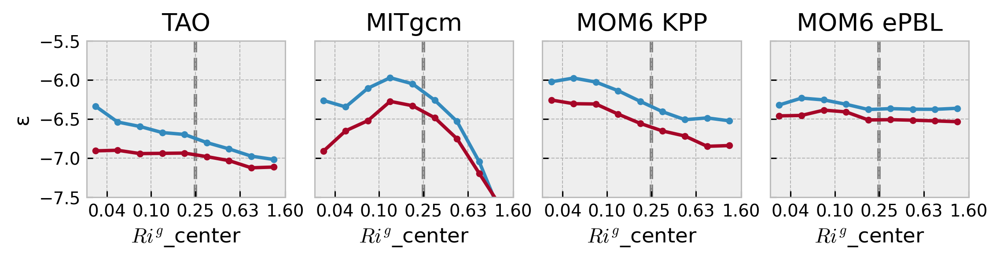

In [ ]:
f, ax = plt.subplots(
    1, len(datasets), sharex=True, sharey=True, constrained_layout=True
)
for axx, (name, ds) in zip(ax, datasets.items()):
    da = np.log10(ds.eps_ri)
    # da["Rig_T_bins"] = pd.Index(
    #    [pd.Interval(np.log10(i.left), np.log10(i.right))
    #     for i in tao_gridded.Rig_T_bins.data]
    # )
    (
        da.sel(stat="mean")
        .sel(enso_transition_phase=["La-Nina cool", "El-Nino warm"])
        .plot(hue="enso_transition_phase", marker=".", ax=axx, add_legend=False)
    )
    axx.set_title(name)

    ticks = [0.04, 0.1, 0.25, 0.63, 1.6]
    # axx.set_yticks([-7.25, -7, -6.5, -6])
    axx.set_ylim([-7.5, -5.5])
    axx.set_xticks(np.log10(ticks))
    axx.set_xticklabels([f"{a:.2f}" for a in ticks])
    # axx.tick_params(axis='x', rotation=30)
ax[0].set_ylabel("ε")
dcpy.plots.linex(np.log10(0.25), ax=ax)
dcpy.plots.clean_axes(ax)
f.set_size_inches((8, 2))

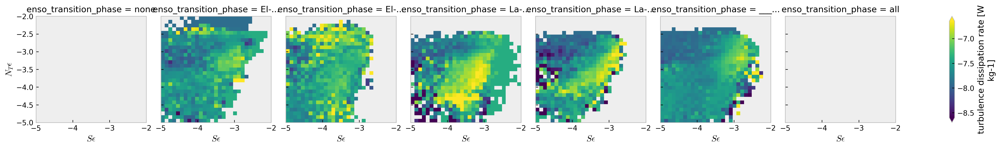

In [ ]:
np.log10(tao_gridded.eps_n2s2).plot(robust=True, col="enso_transition_phase")

## Seasonal mean heat flux

In [ ]:
remapped.Jq.load()

<xarray.DataArray 'Jq' (time: 174000, zeuc: 100)>
array([[        nan,         nan, -0.07841657, ...,         nan,
                nan,         nan],
       [        nan,         nan, -0.07973828, ...,         nan,
                nan,         nan],
       [        nan,         nan, -0.08094554, ...,         nan,
                nan,         nan],
       ...,
       [        nan, -0.07447129,         nan, ...,         nan,
                nan,         nan],
       [        nan, -0.07471326,         nan, ...,         nan,
                nan,         nan],
       [        nan, -0.07509062,         nan, ...,         nan,
                nan,         nan]])
Coordinates:
    latitude   float64 0.025
    longitude  float64 -140.0
  * time       (time) datetime64[ns] 1998-12-31T18:00:00 ... 2018-11-06T17:00:00
  * zeuc       (zeuc) float64 -247.5 -242.5 -237.5 -232.5 ... 237.5 242.5 247.5

In [ ]:
import hvplot.xarray

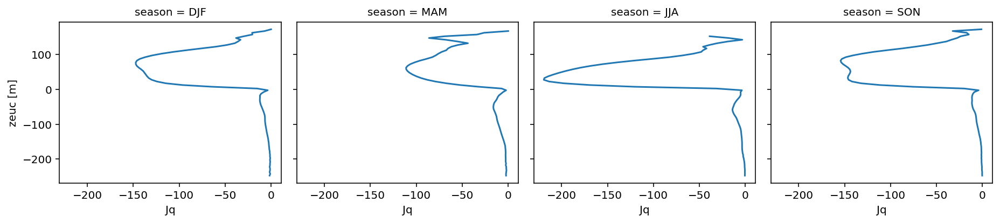

In [ ]:
(
    remapped.Jq.groupby("time.season")
    .mean()
    .reindex(season=["DJF", "MAM", "JJA", "SON"])
    .cf.plot.line(col="season")
)

## Test out available variables


1. `KPP_Kheat` is non-zero only in KPP_OBL

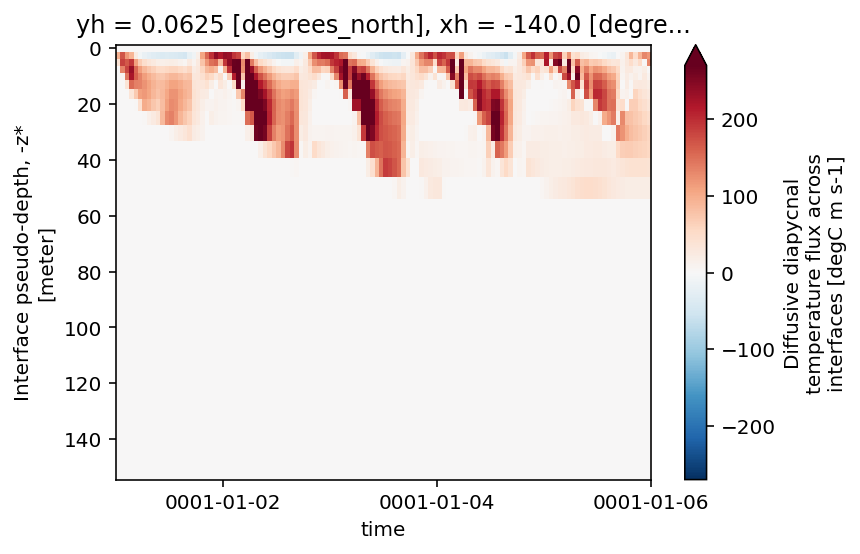

In [ ]:
(mom6140.Tflx_dia_diff * 1025 * 4000).cf.plot(robust=True)

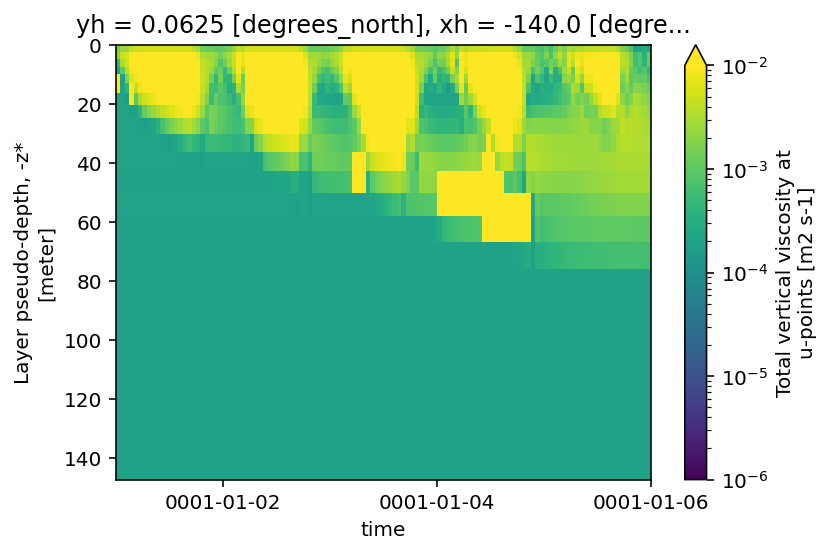

In [ ]:
mom6140.Kv_u.cf.plot(norm=mpl.colors.LogNorm(1e-6, 1e-2))

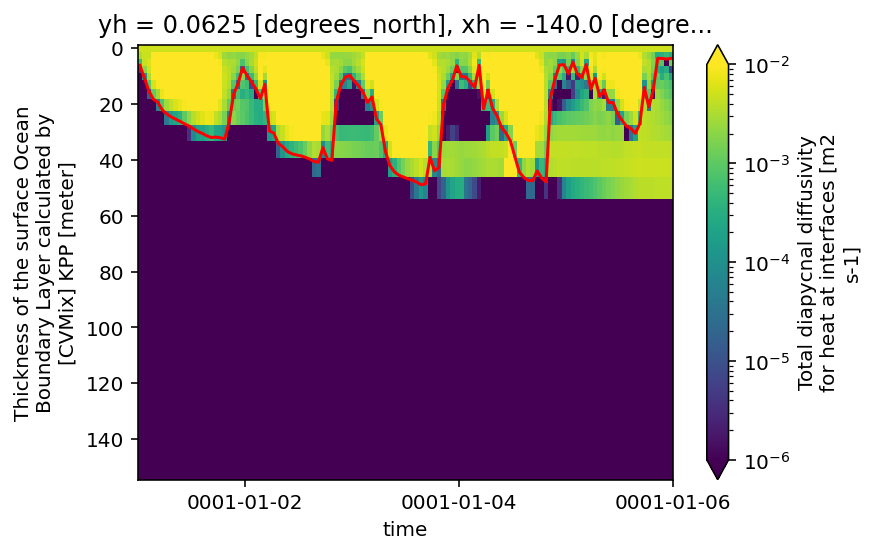

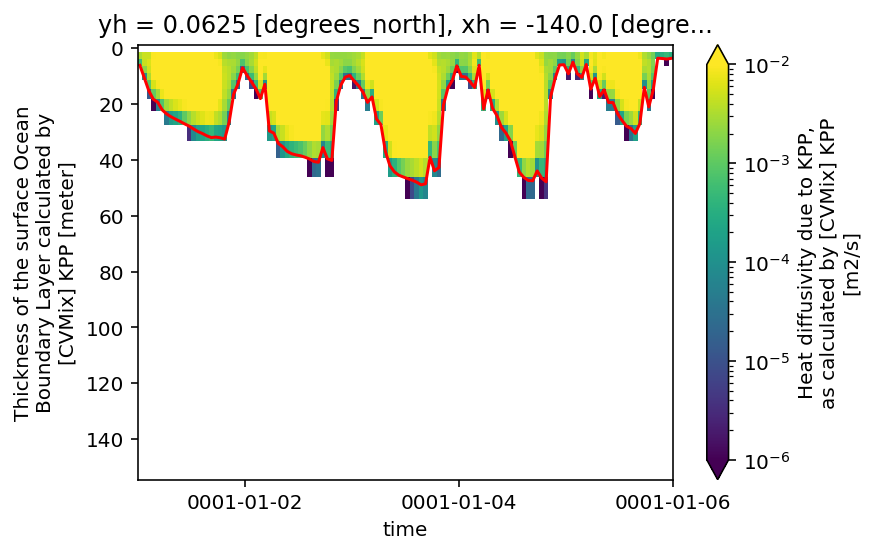

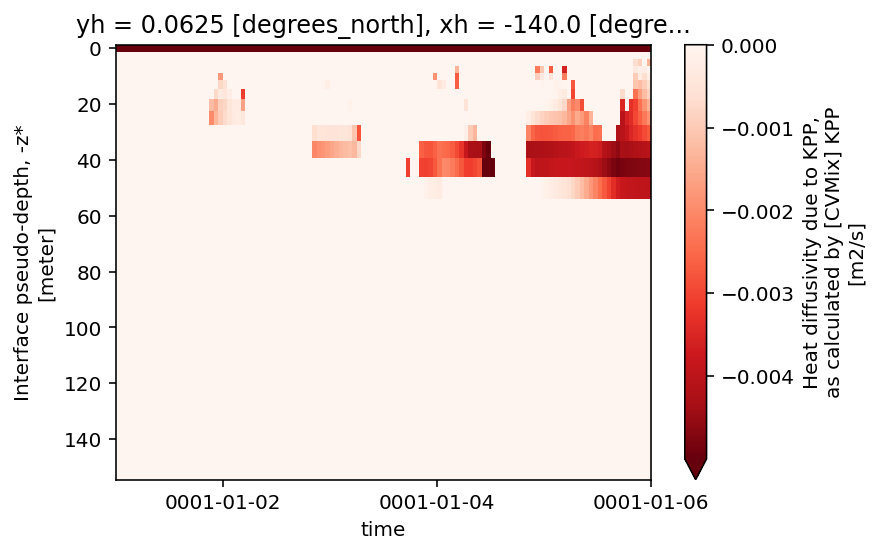

In [ ]:
mom6140.Kd_heat.cf.plot(norm=mpl.colors.LogNorm(1e-6, 1e-2))
mom6140.KPP_OBLdepth.plot(color="r")

plt.figure()
mom6140.KPP_kheat.cf.plot(norm=mpl.colors.LogNorm(1e-6, 1e-2))
mom6140.KPP_OBLdepth.plot(color="r")

plt.figure()
(mom6140.KPP_kheat - mom6140.Kd_heat).cf.plot(
    robust=True, cmap=mpl.cm.mpl.cm.Reds_r, vmax=0
)

## Experiment with manual combining

In [ ]:
import intake
from intake.source.utils import reverse_format

years = []
tiles = []
for file in files[:10]:
    p = pathlib.Path(file)
    params = reverse_format("__{year}.nc.{tile}", p.stem + p.suffix)
    years.append(params["year"])
    tiles.append(params["tile"])
years, tiles

import toolz as tlz

bytile = {}
for tile, v in tlz.groupby(tileid, files).items():
    bytile[tile] = xr.concat(read_raw_files(v, parallel=True), dim="time")


print("\n".join([hash(ds.yh.data.tolist()) for ds in list(bytile.values())]))

from functools import partial


def hash_coords(ds, axis):
    dims = ds.cf.axes[axis]
    data = np.concatenate([ds[dim].data for dim in dims])
    return hash(tuple(data))


grouped = bytile

for axis, concat_axis in [("X", "Y"), ("Y", "X")]:
    grouped = tlz.groupby(partial(hash_coords, axis=axis), grouped.values())
    grouped = {
        k: cfconcat(v, axis=concat_axis, join="exact") for k, v in grouped.items()
    }
    break
grouped

cfconcat(list(grouped.values()), "X")

combined = xr.combine_by_coords(list(bytile.values()), combine_attrs="override")


def raise_if_bad_index(combined):
    bad = []
    for idx in combined.indexes:
        index = combined.indexes[idx]
        if not index.is_monotonic or index.has_duplicates:
            bad.append(idx)
    if bad:
        raise ValueError(f"Indexes {idx} are either not monotonic or have duplicates")


def tileid(path):
    p = pathlib.Path(path)
    # print(p.suffix)
    # params = reverse_format("__{year}.nc.{tile}", p.stem + p.suffix)
    return int(p.suffix[1:])  # params["tile"]
    # years.append(params["year"])
    # tiles.append(params["tile"])


sorted_files = sorted(files, key=tileid)
for tile, files in groupby(sorted_files, tileid):
    print(tile, len(list(files)))

## Test out ONI 

### Phase labeling

In [ ]:
oni = pump.obs.process_oni().sel(time=slice("2005-Sep", None))
enso_transition = mixpods.make_enso_transition_mask(oni)
mixpods.plot_enso_transition(oni, enso_transition)

:Overlay
   .Bars.I   :Bars   [time,Variable]   (value)
   .Bars.II  :Bars   [time,Variable]   (value)
   .Bars.III :Bars   [time,Variable]   (value)
   .Bars.IV  :Bars   [time,Variable]   (value)
   .Bars.V   :Bars   [time,Variable]   (value)

### Replicate ONI calculation

close enough!

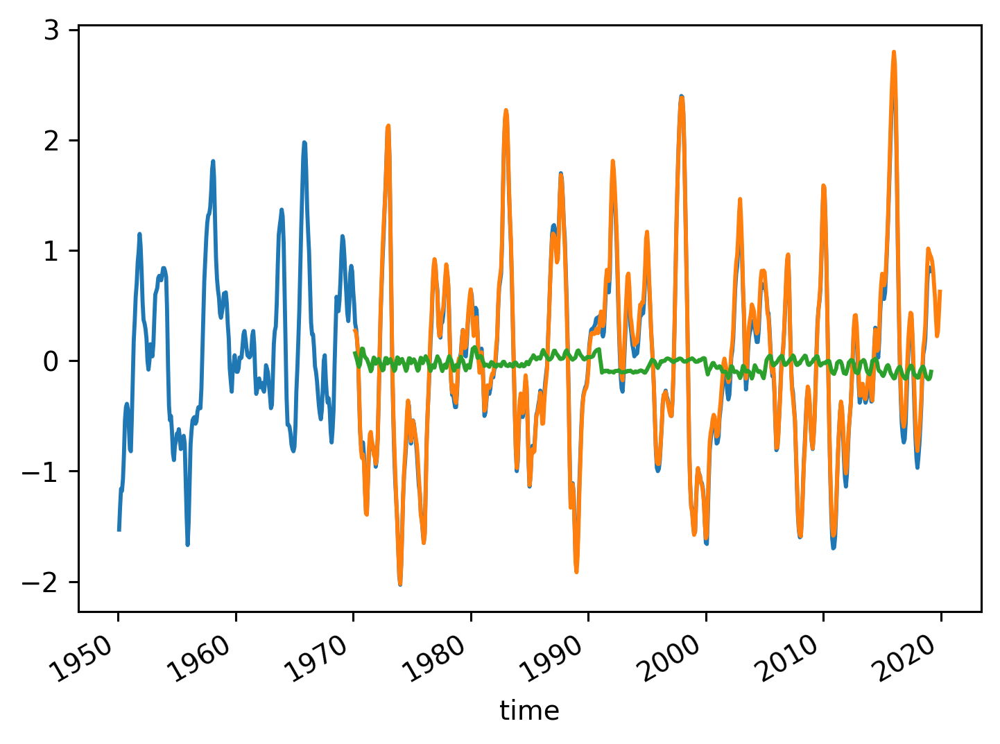

In [ ]:
ersst = xr.tutorial.open_dataset("ersstv5")

monthlyersst = (
    ersst.sst.cf.sortby("Y")
    .cf.sel(latitude=slice(-5, 5), longitude=slice(360 - 170, 360 - 120))
    .cf.mean(["X", "Y"])
    .resample(time="M")
    .mean()
    .load()
)

expected = mixpods.calc_oni(monthlyersst)

actual = pump.obs.process_oni()
actual.plot()
expected.plot()

(actual - expected).plot()

## Comparing to Warner and Moum code

In [ ]:
chipod.eps.sel(time="2007-01-14 10:35:00", method="nearest").load()

<xarray.DataArray 'eps' (depth: 5)>
nan 3.929e-07 2.846e-07 2.234e-07 4.491e-07
Coordinates:
    time        datetime64[ns] 2007-01-14T11:00:00
  * depth       (depth) float64 -69.0 -59.0 -49.0 -39.0 -29.0
    timeSeries  (depth) float64 69.0 59.0 49.0 39.0 29.0
    lat         (depth) float64 0.0 0.0 0.0 0.0 0.0
    lon         (depth) float64 -140.0 -140.0 -140.0 -140.0 -140.0
Attributes:
    long_name:              turbulence dissipation rate
    standard_name:          specific_turbulent_kinetic_energy_dissipation_in_...
    ncei_name:              turbulent kinetic energy (TKE) dissipation rate
    units:                  W kg-1
    FillValue:              -9999
    valid_min:              1e-12
    valid_max:              9.999999999999999e-06
    coverage_content_type:  physicalMeasurement
    grid_mapping:           crs
    source:                 inferred from fast thermistor spectral scaling
    references:             Moum J.N. and J.D. Nash, Mixing measurements on a...
    cell_methods:           depth: point, time: mean
    platform:               mooring
    instrument:             chipod

In [ ]:
tao_gridded.enso_transition.loc[{"time": slice("2015-12", "2016-01")}]

<xarray.DataArray 'enso_transition' (time: 1488)>
'El-Nino warm' 'El-Nino warm' 'El-Nino warm' ... 'El-Nino warm' 'El-Nino warm'
Coordinates: (12/13)
    deepest             (time) float64 -300.0 -300.0 -300.0 ... -300.0 -300.0
    eucmax              (time) float64 -135.0 -140.0 -135.0 ... -140.0 -135.0
    latitude            float32 0.0
    longitude           float32 -140.0
    mld                 (time) float64 -9.0 -8.0 -8.0 -8.0 ... nan nan nan nan
    mldT                (time) float64 -10.0 -8.0 -8.0 -8.0 ... nan nan nan nan
    ...                  ...
    shallowest          (time) float64 -5.0 -5.0 -5.0 -5.0 ... -10.0 -10.0 -10.0
  * time                (time) datetime64[ns] 2015-12-01 ... 2016-01-31T23:00:00
    oni                 (time) float32 2.53 2.53 2.53 2.53 ... 2.53 2.53 2.53
    warm_mask           (time) bool True True True True ... False False False
    cool_mask           (time) bool False False False False ... True True True
    enso_transition     (time) <U12 'El-Nino warm' ... 'El-Nino warm'
Attributes:
    description:  Warner & Moum (2019) ENSO transition phase; El-Nino = ONI >...

## Extra code